In [ ]:
#imports
import os
import pickle
from itertools import combinations
from tqdm import tqdm
from google.colab import drive

import numpy as np
from scipy import stats
from scipy.stats import bootstrap

from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import roc_curve, auc

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import (
    Dense,
    Conv2D,
    MaxPooling2D,
    GlobalAveragePooling2D,
    Dropout,
    BatchNormalization,
    Input
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications import MobileNetV2, ResNet50
from tensorflow.keras.mixed_precision import set_global_policy
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.metrics import sparse_categorical_accuracy
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

In [ ]:
tf.keras.mixed_precision.set_global_policy('mixed_float16')
print("Mixed precision enabled")

def setup_data_pipeline(data_dir, image_size=(128, 128), batch_size=32):
    """Creates an optimized data pipeline for SAR image classification"""
    AUTOTUNE = tf.data.AUTOTUNE

    @tf.function
    def preprocess(image, label):
        image = tf.cast(image, tf.float32) / 255.0
        return image, label

    train_ds = tf.keras.utils.image_dataset_from_directory(
        data_dir,
        validation_split=0.2,
        subset="training",
        seed=123,
        image_size=image_size,
        batch_size=batch_size,
        shuffle=True
    )

    val_ds = tf.keras.utils.image_dataset_from_directory(
        data_dir,
        validation_split=0.2,
        subset="validation",
        seed=123,
        image_size=image_size,
        batch_size=batch_size
    )

    class_names = train_ds.class_names
    print("\nClasses:", class_names)
    print(f"Number of classes: {len(class_names)}")

    train_ds = (train_ds
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .cache()
        .prefetch(buffer_size=AUTOTUNE))

    val_ds = (val_ds
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .cache()
        .prefetch(buffer_size=AUTOTUNE))

    return train_ds, val_ds, class_names


Mixed precision enabled


In [ ]:
# Mount Drive
if not os.path.exists('/content/drive'):
    drive.mount('/content/drive')

def setup_directories():
    """Create organized directory structure in Colab environment"""
    base_dir = '/content/mstar_project'
    directories = {
        'data': os.path.join(base_dir, 'data'),
        'models': os.path.join(base_dir, 'models'),
        'results': os.path.join(base_dir, 'results'),
        'drive_models': '/content/drive/My Drive/Fall 2024/Senior Thesis/models'
    }

    for dir_path in directories.values():
        os.makedirs(dir_path, exist_ok=True)

    return directories

def setup_kaggle_credentials():
    """Setup Kaggle credentials from Drive"""
    kaggle_path = '/content/drive/My Drive/Fall 2024/Senior Thesis/kaggle.json'

    if not os.path.exists('/root/.kaggle'):
        os.makedirs('/root/.kaggle')
    !cp "{kaggle_path}" /root/.kaggle/
    !chmod 600 /root/.kaggle/kaggle.json

def download_and_setup_data(directories):
    """Download and extract the dataset to Colab environment"""
    data_path = os.path.join(directories['data'], 'mstar-dataset-8-classes.zip')

    print("Installing Kaggle API...")
    !pip install -q kaggle

    print("Setting up Kaggle credentials...")
    setup_kaggle_credentials()

    print("Downloading dataset...")
    !kaggle datasets download atreyamajumdar/mstar-dataset-8-classes -p {directories['data']} -q

    print("Extracting dataset...")
    !unzip -q {data_path} -d {directories['data']}
    os.remove(data_path)

directories = setup_directories()

# Download data
try:
    download_and_setup_data(directories)
except Exception as e:
    print(f"Error setting up data: {str(e)}")
    raise

def setup_data_pipeline(data_dir, image_size=(128, 128), batch_size=32):
    """Creates an optimized data pipeline for SAR image classification"""
    AUTOTUNE = tf.data.AUTOTUNE

    @tf.function
    def preprocess(image, label):
        image = tf.cast(image, tf.float32) / 255.0
        return image, label

    train_ds = tf.keras.utils.image_dataset_from_directory(
        data_dir,
        validation_split=0.2,
        subset="training",
        seed=123,
        image_size=image_size,
        batch_size=batch_size,
        shuffle=True
    )

    val_ds = tf.keras.utils.image_dataset_from_directory(
        data_dir,
        validation_split=0.2,
        subset="validation",
        seed=123,
        image_size=image_size,
        batch_size=batch_size
    )

    class_names = train_ds.class_names
    print("\nClasses:", class_names)
    print(f"Number of classes: {len(class_names)}")

    train_ds = (train_ds
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .cache()
        .prefetch(buffer_size=AUTOTUNE))

    val_ds = (val_ds
        .map(preprocess, num_parallel_calls=AUTOTUNE)
        .cache()
        .prefetch(buffer_size=AUTOTUNE))

    return train_ds, val_ds, class_names

images_path = os.path.join(directories['data'], 'Padded_imgs')
train_ds, val_ds, class_names = setup_data_pipeline(images_path)

Mounted at /content/drive
Installing Kaggle API...
Setting up Kaggle credentials...
Dataset URL: https://www.kaggle.com/datasets/atreyamajumdar/mstar-dataset-8-classes
License(s): unknown
Extracting dataset...
Found 9466 files belonging to 8 classes.
Using 7573 files for training.
Found 9466 files belonging to 8 classes.
Using 1893 files for validation.

Classes: ['2S1', 'BRDM_2', 'BTR_60', 'D7', 'SLICY', 'T62', 'ZIL131', 'ZSU_23_4']
Number of classes: 8


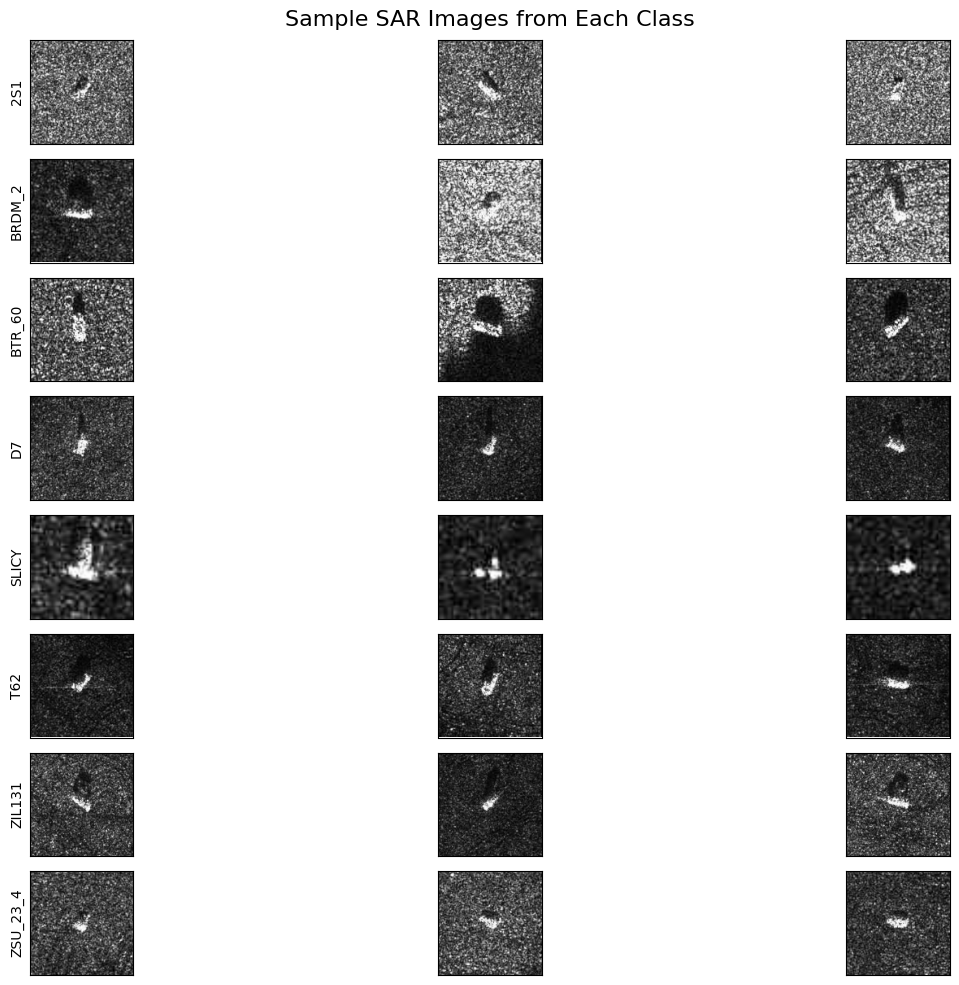


Dataset Information:
Number of classes: 8
Class names: 2S1, BRDM_2, BTR_60, D7, SLICY, T62, ZIL131, ZSU_23_4

Image properties:
Image shape: (128, 128, 3)
Data type: <dtype: 'float32'>
Value range: [0.00, 1.00]


In [ ]:
def visualize_dataset_samples(train_ds, class_names, samples_per_class=3):
    """
    Visualize sample images from each class in the dataset
    Args:
        train_ds: Training dataset
        class_names: List of class names
        samples_per_class: Number of samples to show per class
    """
    plt.figure(figsize=(15, 10))

    class_samples = {class_name: [] for class_name in class_names}

    for images, labels in train_ds:
        for image, label in zip(images, labels):
            class_name = class_names[label]
            if len(class_samples[class_name]) < samples_per_class:
                class_samples[class_name].append(image)

        if all(len(samples) >= samples_per_class for samples in class_samples.values()):
            break

    for idx, class_name in enumerate(class_names):
        for j in range(samples_per_class):
            plt.subplot(len(class_names), samples_per_class,
                       idx * samples_per_class + j + 1)
            plt.imshow(class_samples[class_name][j].numpy())
            if j == 0:
                plt.ylabel(class_name)
            plt.xticks([])
            plt.yticks([])

    plt.suptitle('Sample SAR Images from Each Class', fontsize=16)
    plt.tight_layout()
    plt.show()

    print("\nDataset Information:")
    print("=" * 50)
    print(f"Number of classes: {len(class_names)}")
    print(f"Class names: {', '.join(class_names)}")
    print("\nImage properties:")
    sample_image = next(iter(train_ds))[0][0]
    print(f"Image shape: {sample_image.shape}")
    print(f"Data type: {sample_image.dtype}")
    print(f"Value range: [{tf.reduce_min(sample_image):.2f}, {tf.reduce_max(sample_image):.2f}]")

visualize_dataset_samples(train_ds, class_names)

In [ ]:
class ModelFactory:
    """Factory class for creating different CNN architectures"""

    @staticmethod
    def create_baseline_cnn():
      """Enhanced baseline CNN with better feature extraction"""
      model = Sequential([
          Conv2D(64, 3, activation='relu', padding='same', input_shape=(128, 128, 3)),
          BatchNormalization(),
          Conv2D(64, 3, activation='relu', padding='same'),
          MaxPooling2D(2),

          Conv2D(128, 3, activation='relu', padding='same'),
          BatchNormalization(),
          Conv2D(128, 3, activation='relu', padding='same'),
          MaxPooling2D(2),

          Dropout(0.3),

          Conv2D(256, 3, activation='relu', padding='same'),
          BatchNormalization(),
          GlobalAveragePooling2D(),

          Dense(128, activation='relu'),
          Dropout(0.4),
          Dense(8, activation='softmax')
      ])

      model.compile(
          optimizer=Adam(learning_rate=1e-4),
          loss='sparse_categorical_crossentropy',
          metrics=['accuracy']
      )

      return model, "Baseline CNN"

    @staticmethod
    def create_deeper_cnn():
        """Optimized deeper CNN with essential features only"""
        model = Sequential([

            Conv2D(64, 3, activation='relu', padding='same', input_shape=(128, 128, 3)),
            Conv2D(64, 3, activation='relu', padding='same'),
            MaxPooling2D(2),

            Conv2D(128, 3, activation='relu', padding='same'),
            Conv2D(128, 3, activation='relu', padding='same'),
            MaxPooling2D(2),
            Dropout(0.3),

            Conv2D(256, 3, activation='relu', padding='same'),
            Conv2D(256, 3, activation='relu', padding='same'),
            MaxPooling2D(2),
            Dropout(0.4),

            GlobalAveragePooling2D(),
            Dense(256, activation='relu'),
            Dropout(0.5),
            Dense(8, activation='softmax')
        ])
        ModelFactory._compile_model(model)
        return model, "Deeper CNN"

    @staticmethod
    def create_efficient_cnn():
        """Memory-efficient CNN with aggressive pooling"""
        model = Sequential([
            Conv2D(32, 5, activation='relu', padding='same', input_shape=(128, 128, 3)),
            MaxPooling2D(4),
            Conv2D(64, 3, activation='relu', padding='same'),
            MaxPooling2D(4),
            Conv2D(128, 3, activation='relu', padding='same'),
            MaxPooling2D(2),
            GlobalAveragePooling2D(),
            Dropout(0.4),
            Dense(8, activation='softmax')
        ])
        ModelFactory._compile_model(model)
        return model, "Efficient CNN"

    @staticmethod
    def create_mobilenetv2_model():
        """Optimized MobileNetV2 with streamlined top layers"""
        inputs = Input(shape=(128, 128, 3))
        base_model = MobileNetV2(
            input_shape=(128, 128, 3),
            include_top=False,
            weights='imagenet'
        )
        base_model.trainable = False
        x = base_model(inputs)
        x = GlobalAveragePooling2D()(x)
        x = Dense(128, activation='relu')(x)
        x = Dropout(0.5)(x)
        outputs = Dense(8, activation='softmax')(x)
        model = Model(inputs=inputs, outputs=outputs)
        ModelFactory._compile_model(model)
        return model, "MobileNetV2"

    @staticmethod
    def create_resnet50_model():
        """Optimized ResNet50 with streamlined top layers"""
        inputs = Input(shape=(128, 128, 3))
        base_model = ResNet50(
            input_shape=(128, 128, 3),
            include_top=False,
            weights='imagenet'
        )
        base_model.trainable = False
        x = base_model(inputs)
        x = GlobalAveragePooling2D()(x)
        x = Dense(256, activation='relu')(x)
        x = Dropout(0.5)(x)
        outputs = Dense(8, activation='softmax')(x)
        model = Model(inputs=inputs, outputs=outputs)
        ModelFactory._compile_model(model)
        return model, "ResNet50"

    @staticmethod
    def _compile_model(model):
        """Common compilation settings"""
        model.compile(
            optimizer=Adam(learning_rate=1e-3),
            loss='sparse_categorical_crossentropy',
            metrics=['accuracy']
        )

def get_models():
    """Get list of all model architectures"""
    return [
        ModelFactory.create_baseline_cnn(),
        ModelFactory.create_deeper_cnn(),
        ModelFactory.create_efficient_cnn(),
        ModelFactory.create_mobilenetv2_model(),
        ModelFactory.create_resnet50_model()
    ]

In [ ]:
def train_single_model(model, model_name, train_ds, val_ds, save_dir):
    """Fast training with essential features only"""
    print(f"\n{'='*50}")
    print(f"Training {model_name}...")
    print(f"{'='*50}")

    tf.keras.backend.clear_session()

    model.summary()

    callbacks = [
        EarlyStopping(
            monitor='val_accuracy',
            patience=5,
            restore_best_weights=True,
            verbose=1
        ),
        ReduceLROnPlateau(
            monitor='val_accuracy',
            factor=0.5,
            patience=3,
            min_lr=1e-6,
            verbose=1
        )
    ]

    if model_name in ['MobileNetV2', 'ResNet50']:
        print("\nStarting transfer learning...")

        history1 = model.fit(
            train_ds,
            validation_data=val_ds,
            epochs=5,
            callbacks=callbacks,
            verbose=1
        )

        base_model = model.layers[1]
        base_model.trainable = True

        n_layers = len(base_model.layers)
        n_frozen = int(0.8 * n_layers)
        for layer in base_model.layers[:n_frozen]:
            layer.trainable = False

        model.compile(
            optimizer=Adam(learning_rate=1e-5),
            loss='sparse_categorical_crossentropy',
            metrics=['accuracy']
        )

        history2 = model.fit(
            train_ds,
            validation_data=val_ds,
            epochs=5,
            callbacks=callbacks,
            verbose=1
        )

        history = {}
        for key in history1.history:
            history[key] = history1.history[key] + history2.history[key]
    else:
        history = model.fit(
            train_ds,
            validation_data=val_ds,
            epochs=15,
            callbacks=callbacks,
            verbose=1
        ).history

    model_path = os.path.join(save_dir, f'{model_name.lower().replace(" ", "_")}.keras')
    model.save(model_path)
    print(f"\nModel saved as: {model_path}")

    return {
        'model': model,
        'history': history
    }

In [ ]:
models_dir = '/content/mstar_project/models'
os.makedirs(models_dir, exist_ok=True)

# Baseline CNN
model, model_name = ModelFactory.create_baseline_cnn()
baseline_results = train_single_model(model, model_name, train_ds, val_ds, models_dir)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)



Training Baseline CNN...


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 128, 128, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 128, 128, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 64, 64, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 32, 32, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 256)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │           1,032 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 591,048 (2.25 MB)

 Trainable params: 590,152 (2.25 MB)

 Non-trainable params: 896 (3.50 KB)

Epoch 1/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 40s 83ms/step - accuracy: 0.5239 - loss: 1.3363 - val_accuracy: 0.1284 - val_loss: 6.8425 - learning_rate: 1.0000e-04
Epoch 2/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8130 - loss: 0.5162 - val_accuracy: 0.1284 - val_loss: 5.6611 - learning_rate: 1.0000e-04
Epoch 3/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8657 - loss: 0.3577 - val_accuracy: 0.6492 - val_loss: 0.7868 - learning_rate: 1.0000e-04
Epoch 4/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.8793 - loss: 0.2974 - val_accuracy: 0.9065 - val_loss: 0.2094 - learning_rate: 1.0000e-04
Epoch 5/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.9020 - loss: 0.2473 - val_accuracy: 0.9028 - val_loss: 0.2126 - learning_rate: 1.0000e-04
Epoch 6/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.9067 - loss: 0.2233 - val_accuracy: 0.8991 - val_loss: 0.2282 - learning_rate: 1.0000e-04
Epoch 7/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy

In [ ]:
# Deeper CNN
model, model_name = ModelFactory.create_deeper_cnn()
deeper_results = train_single_model(model, model_name, train_ds, val_ds, models_dir)


Training Deeper CNN...


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 128, 128, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 32, 32, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 256)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │           2,056 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,213,256 (4.63 MB)

 Trainable params: 1,213,256 (4.63 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 30s 74ms/step - accuracy: 0.2527 - loss: 1.7914 - val_accuracy: 0.4649 - val_loss: 1.1207 - learning_rate: 0.0010
Epoch 2/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.6584 - loss: 0.8030 - val_accuracy: 0.9160 - val_loss: 0.2426 - learning_rate: 0.0010
Epoch 3/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.8667 - loss: 0.3028 - val_accuracy: 0.8928 - val_loss: 0.2117 - learning_rate: 0.0010
Epoch 4/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.9038 - loss: 0.2167 - val_accuracy: 0.9287 - val_loss: 0.1908 - learning_rate: 0.0010
Epoch 5/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.9133 - loss: 0.2046 - val_accuracy: 0.8780 - val_loss: 0.2304 - learning_rate: 0.0010
Epoch 6/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.9171 - loss: 0.1963 - val_accuracy: 0.9461 - val_loss: 0.1316 - learning_rate: 0.0010
Epoch 7/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 14ms/step - accuracy: 0.9215 - loss: 0

In [ ]:
# Efficient CNN
model, model_name = ModelFactory.create_efficient_cnn()
efficient_results = train_single_model(model, model_name, train_ds, val_ds, models_dir)


Training Efficient CNN...


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 128, 128, 32)        │           2,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 32, 32, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 8, 8, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 8, 8, 128)           │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 4, 4, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 128)                 │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 8)                   │           1,032 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 95,816 (374.28 KB)

 Trainable params: 95,816 (374.28 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 9s 26ms/step - accuracy: 0.3082 - loss: 1.7399 - val_accuracy: 0.7348 - val_loss: 0.8910 - learning_rate: 0.0010
Epoch 2/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7512 - loss: 0.6997 - val_accuracy: 0.8399 - val_loss: 0.3613 - learning_rate: 0.0010
Epoch 3/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8497 - loss: 0.3765 - val_accuracy: 0.8595 - val_loss: 0.2901 - learning_rate: 0.0010
Epoch 4/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8664 - loss: 0.3319 - val_accuracy: 0.8653 - val_loss: 0.2782 - learning_rate: 0.0010
Epoch 5/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8791 - loss: 0.3042 - val_accuracy: 0.8732 - val_loss: 0.2474 - learning_rate: 0.0010
Epoch 6/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8977 - loss: 0.2721 - val_accuracy: 0.9102 - val_loss: 0.1947 - learning_rate: 0.0010
Epoch 7/15
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8983 - loss: 0.2473 -

In [ ]:
# MobileNetV2
model, model_name = ModelFactory.create_mobilenetv2_model()
mobilenet_results = train_single_model(model, model_name, train_ds, val_ds, models_dir)

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step

Training MobileNetV2...


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ mobilenetv2_1.00_128 (Functional)    │ (None, 4, 4, 1280)          │       2,257,984 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 1280)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │         163,968 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │           1,032 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,422,984 (9.24 MB)

 Trainable params: 165,000 (644.53 KB)

 Non-trainable params: 2,257,984 (8.61 MB)


Starting transfer learning...
Epoch 1/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 25s 62ms/step - accuracy: 0.6699 - loss: 0.9584 - val_accuracy: 0.9118 - val_loss: 0.2511 - learning_rate: 0.0010
Epoch 2/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8973 - loss: 0.2954 - val_accuracy: 0.9461 - val_loss: 0.1644 - learning_rate: 0.0010
Epoch 3/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.9233 - loss: 0.2218 - val_accuracy: 0.9572 - val_loss: 0.1170 - learning_rate: 0.0010
Epoch 4/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.9445 - loss: 0.1658 - val_accuracy: 0.9498 - val_loss: 0.1213 - learning_rate: 0.0010
Epoch 5/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.9523 - loss: 0.1393 - val_accuracy: 0.9625 - val_loss: 0.0973 - learning_rate: 0.0010
Restoring model weights from the end of the best epoch: 5.
Epoch 1/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 28s 56ms/step - accuracy: 0.5324 - loss: 2.6468 - val_accuracy: 0.8605 - val_loss: 0.4182 - learning_rate: 1.0000e

In [ ]:
# ResNet50
model, model_name = ModelFactory.create_resnet50_model()
resnet_results = train_single_model(model, model_name, train_ds, val_ds, models_dir)

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step

Training ResNet50...


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ resnet50 (Functional)                │ (None, 4, 4, 2048)          │      23,587,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │         524,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 8)                   │           2,056 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 24,114,312 (91.99 MB)

 Trainable params: 526,600 (2.01 MB)

 Non-trainable params: 23,587,712 (89.98 MB)


Starting transfer learning...
Epoch 1/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 28s 68ms/step - accuracy: 0.2089 - loss: 2.0335 - val_accuracy: 0.3724 - val_loss: 1.7186 - learning_rate: 0.0010
Epoch 2/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.3530 - loss: 1.6844 - val_accuracy: 0.4321 - val_loss: 1.5608 - learning_rate: 0.0010
Epoch 3/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.4062 - loss: 1.5290 - val_accuracy: 0.4617 - val_loss: 1.4284 - learning_rate: 0.0010
Epoch 4/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.4494 - loss: 1.4140 - val_accuracy: 0.4818 - val_loss: 1.3391 - learning_rate: 0.0010
Epoch 5/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.4841 - loss: 1.3274 - val_accuracy: 0.5013 - val_loss: 1.2700 - learning_rate: 0.0010
Restoring model weights from the end of the best epoch: 5.
Epoch 1/5
237/237 ━━━━━━━━━━━━━━━━━━━━ 37s 74ms/step - accuracy: 0.4736 - loss: 4.9954 - val_accuracy: 0.1421 - val_loss: 16.6658 - learning_rate: 1.

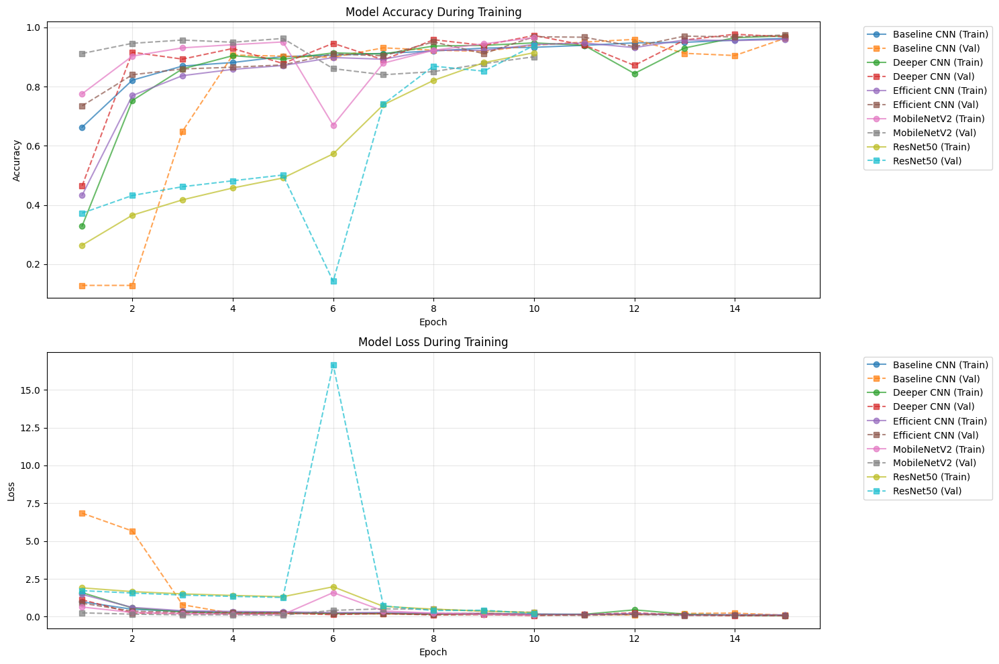


Final Model Performance Summary

Baseline CNN:
Final Training Accuracy: 0.9630
Final Validation Accuracy: 0.9630
Best Validation Accuracy: 0.9630
Final Training Loss: 0.1081
Final Validation Loss: 0.0967
Total Epochs: 15
Best Epoch: 15

Deeper CNN:
Final Training Accuracy: 0.9712
Final Validation Accuracy: 0.9683
Best Validation Accuracy: 0.9768
Final Training Loss: 0.0694
Final Validation Loss: 0.0738
Total Epochs: 15
Best Epoch: 14
Early stopping activated

Efficient CNN:
Final Training Accuracy: 0.9592
Final Validation Accuracy: 0.9741
Best Validation Accuracy: 0.9741
Final Training Loss: 0.1103
Final Validation Loss: 0.0709
Total Epochs: 15
Best Epoch: 15

MobileNetV2:
Final Training Accuracy: 0.9647
Final Validation Accuracy: 0.9007
Best Validation Accuracy: 0.9625
Final Training Loss: 0.1064
Final Validation Loss: 0.2896
Total Epochs: 10
Best Epoch: 5
Early stopping activated

ResNet50:
Final Training Accuracy: 0.9144
Final Validation Accuracy: 0.9387
Best Validation Accuracy: 0

In [ ]:
def visualize_training_results(results_dict):
    """
    Visualize training results for all models
    Args:
        results_dict: Dictionary containing training histories
    """
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 1, 1)
    for model_name, results in results_dict.items():
        history = results['history']
        epochs = range(1, len(history['accuracy']) + 1)

        plt.plot(epochs, history['accuracy'], '-o',
                label=f'{model_name} (Train)', alpha=0.7)
        plt.plot(epochs, history['val_accuracy'], '--s',
                label=f'{model_name} (Val)', alpha=0.7)

    plt.title('Model Accuracy During Training')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)

    plt.subplot(2, 1, 2)
    for model_name, results in results_dict.items():
        history = results['history']
        epochs = range(1, len(history['loss']) + 1)

        plt.plot(epochs, history['loss'], '-o',
                label=f'{model_name} (Train)', alpha=0.7)
        plt.plot(epochs, history['val_loss'], '--s',
                label=f'{model_name} (Val)', alpha=0.7)

    plt.title('Model Loss During Training')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    print("\nFinal Model Performance Summary")
    print("=" * 50)
    for model_name, results in results_dict.items():
        history = results['history']
        print(f"\n{model_name}:")
        print(f"Final Training Accuracy: {history['accuracy'][-1]:.4f}")
        print(f"Final Validation Accuracy: {history['val_accuracy'][-1]:.4f}")
        print(f"Best Validation Accuracy: {max(history['val_accuracy']):.4f}")
        print(f"Final Training Loss: {history['loss'][-1]:.4f}")
        print(f"Final Validation Loss: {history['val_loss'][-1]:.4f}")

        if len(history['accuracy']) > 1:
            print(f"Total Epochs: {len(history['accuracy'])}")

        best_epoch = np.argmax(history['val_accuracy']) + 1
        print(f"Best Epoch: {best_epoch}")
        if best_epoch < len(history['accuracy']):
            print("Early stopping activated")


def analyze_model_performance(model, val_ds, model_name, class_names, max_batches=None, directories=None):
    """Efficient model analysis with batched processing"""
    print(f"\nAnalyzing {model_name}...")

    accuracy_metric = tf.keras.metrics.SparseCategoricalAccuracy()
    predictions_list = []
    labels_list = []
    confidences_list = []

    val_ds_subset = val_ds.take(max_batches) if max_batches else val_ds

    for images, labels in val_ds_subset:
        predictions = model.predict(images, verbose=0)
        pred_classes = tf.argmax(predictions, axis=1)
        confidences = tf.reduce_max(predictions, axis=1)
        accuracy_metric.update_state(labels, predictions)

        predictions_list.append(pred_classes)
        labels_list.append(labels)
        confidences_list.append(confidences)

    all_predictions = tf.concat(predictions_list, axis=0).numpy()
    all_labels = tf.concat(labels_list, axis=0).numpy()
    all_confidences = tf.concat(confidences_list, axis=0).numpy()

    cm = confusion_matrix(all_labels, all_predictions)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names,
                yticklabels=class_names)
    plt.title(f'Confusion Matrix - {model_name}')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

    print(f"\nClassification Report - {model_name}")
    print(classification_report(all_labels, all_predictions, target_names=class_names))

    plt.figure(figsize=(8, 5))
    plt.hist(all_confidences, bins=50, alpha=0.7)
    plt.title(f'Prediction Confidence Distribution - {model_name}')
    plt.xlabel('Confidence')
    plt.ylabel('Count')
    plt.tight_layout()
    plt.show()

    class_accuracies = cm.diagonal() / cm.sum(axis=1)
    plt.figure(figsize=(10, 5))
    plt.bar(class_names, class_accuracies)
    plt.title(f'Per-class Accuracy - {model_name}')
    plt.xticks(rotation=45)
    plt.ylabel('Accuracy')
    plt.tight_layout()
    plt.show()

    if directories:
        plots_dir = os.path.join(directories['results'], 'plots')
        os.makedirs(plots_dir, exist_ok=True)
        plt.savefig(os.path.join(plots_dir, f'{model_name.lower()}_analysis.png'))

    return {
        'accuracy': float(accuracy_metric.result()),
        'class_accuracies': class_accuracies,
        'confidences': all_confidences,
        'confusion_matrix': cm,
        'predictions': all_predictions,
        'labels': all_labels
    }

all_results = {
    'Baseline CNN': baseline_results,
    'Deeper CNN': deeper_results,
    'Efficient CNN': efficient_results,
    'MobileNetV2': mobilenet_results,
    'ResNet50': resnet_results
}

visualize_training_results(all_results)

In [ ]:
# Add confusion matrices, per class accuracy...

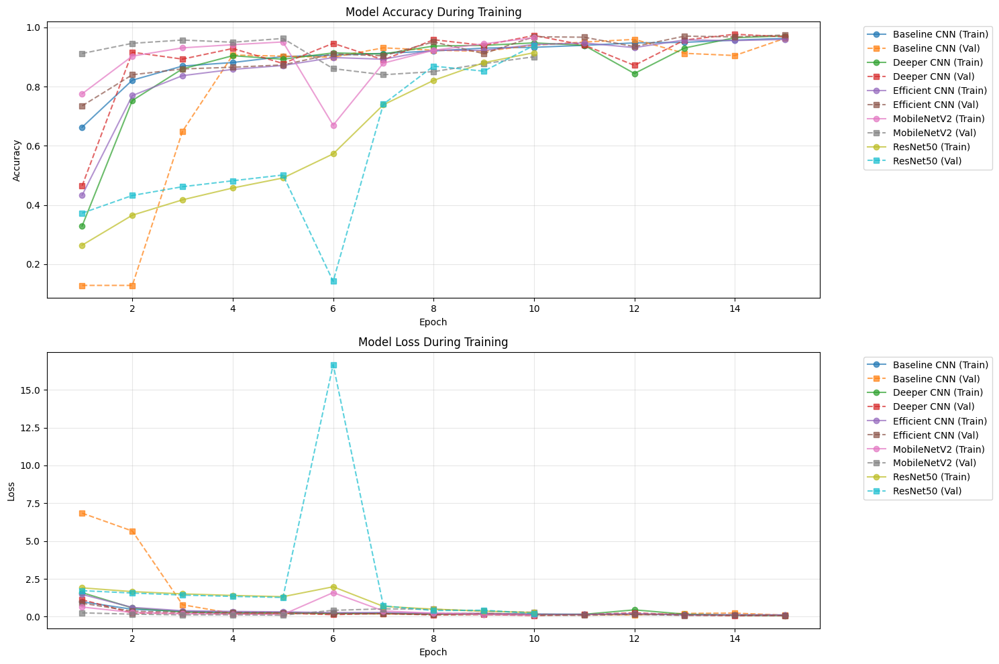


Evaluating Baseline CNN


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'adam', because it has 42 variables whereas the saved optimizer has 46 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))



Analyzing Baseline CNN...


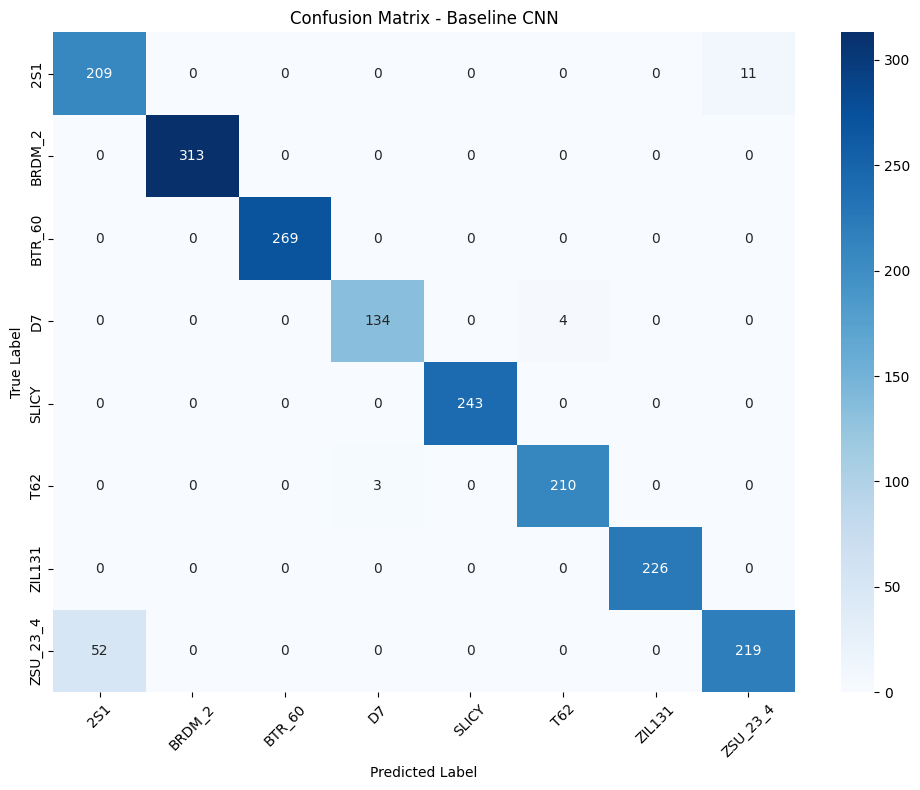


Classification Report - Baseline CNN
              precision    recall  f1-score   support

         2S1       0.80      0.95      0.87       220
      BRDM_2       1.00      1.00      1.00       313
      BTR_60       1.00      1.00      1.00       269
          D7       0.98      0.97      0.97       138
       SLICY       1.00      1.00      1.00       243
         T62       0.98      0.99      0.98       213
      ZIL131       1.00      1.00      1.00       226
    ZSU_23_4       0.95      0.81      0.87       271

    accuracy                           0.96      1893
   macro avg       0.96      0.96      0.96      1893
weighted avg       0.97      0.96      0.96      1893



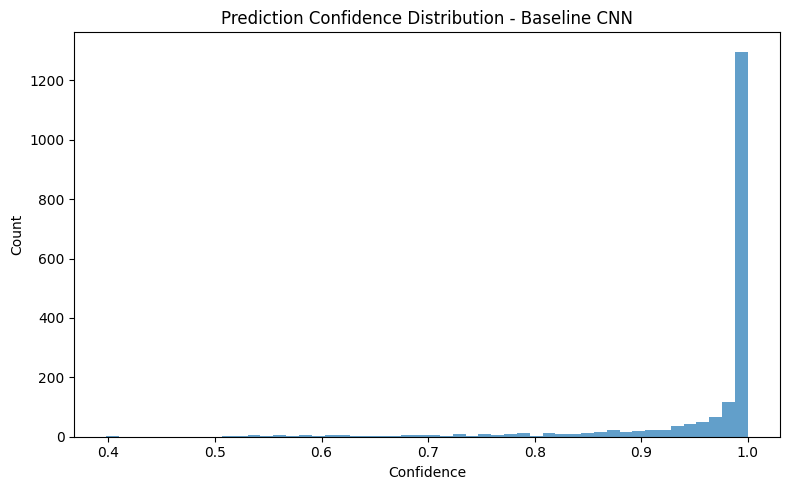

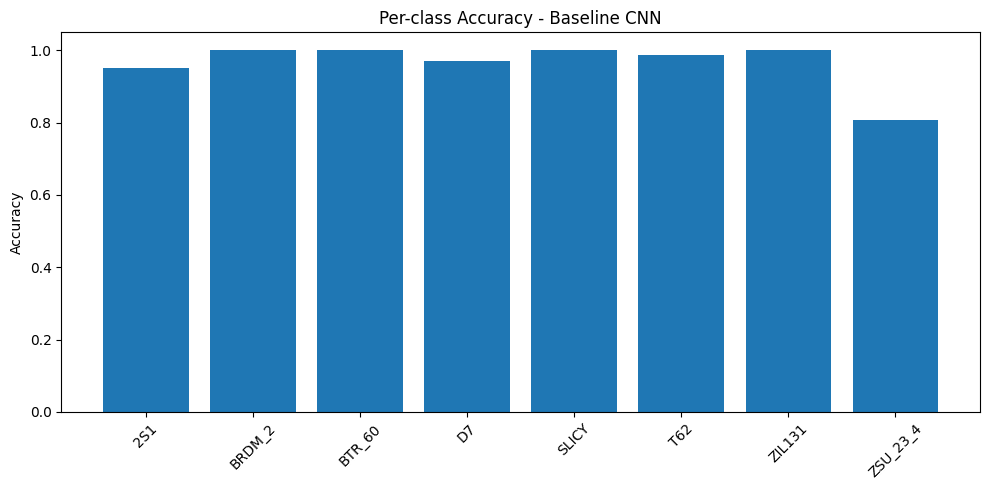

Error evaluating Baseline CNN: name 'test_model_robustness' is not defined

Evaluating Deeper CNN

Analyzing Deeper CNN...


<Figure size 640x480 with 0 Axes>

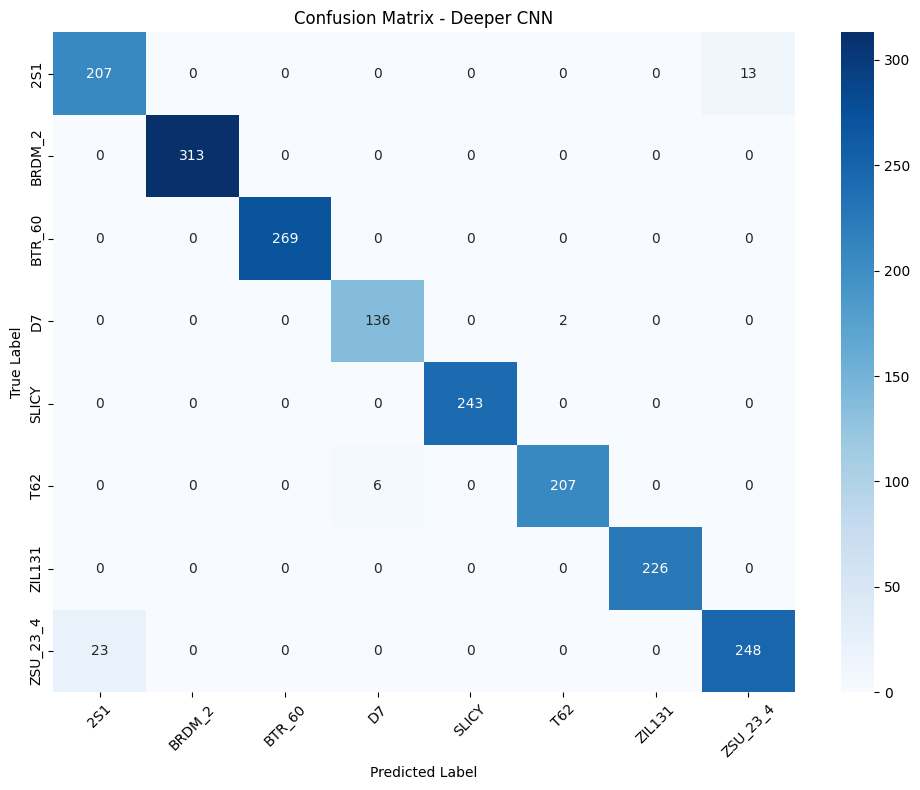


Classification Report - Deeper CNN
              precision    recall  f1-score   support

         2S1       0.90      0.94      0.92       220
      BRDM_2       1.00      1.00      1.00       313
      BTR_60       1.00      1.00      1.00       269
          D7       0.96      0.99      0.97       138
       SLICY       1.00      1.00      1.00       243
         T62       0.99      0.97      0.98       213
      ZIL131       1.00      1.00      1.00       226
    ZSU_23_4       0.95      0.92      0.93       271

    accuracy                           0.98      1893
   macro avg       0.97      0.98      0.98      1893
weighted avg       0.98      0.98      0.98      1893



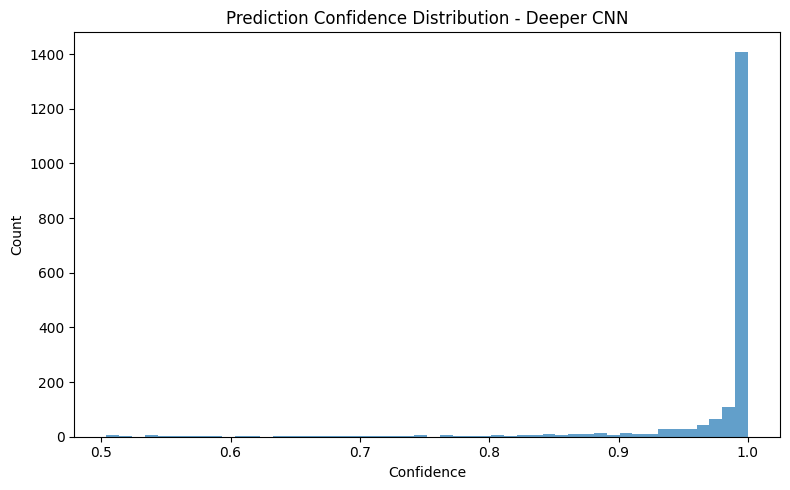

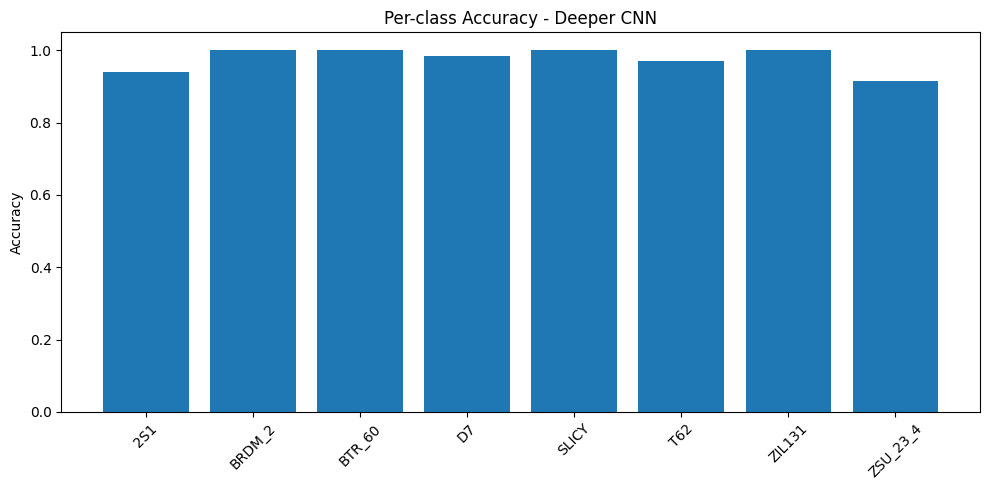

Error evaluating Deeper CNN: name 'test_model_robustness' is not defined

Evaluating Efficient CNN

Analyzing Efficient CNN...


<Figure size 640x480 with 0 Axes>

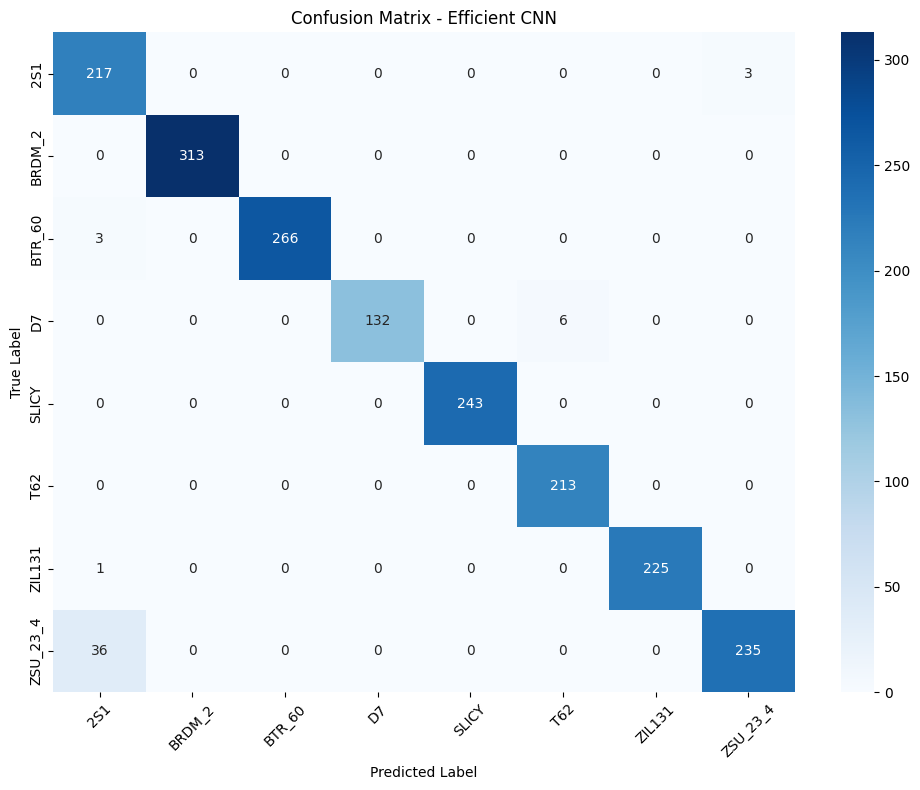


Classification Report - Efficient CNN
              precision    recall  f1-score   support

         2S1       0.84      0.99      0.91       220
      BRDM_2       1.00      1.00      1.00       313
      BTR_60       1.00      0.99      0.99       269
          D7       1.00      0.96      0.98       138
       SLICY       1.00      1.00      1.00       243
         T62       0.97      1.00      0.99       213
      ZIL131       1.00      1.00      1.00       226
    ZSU_23_4       0.99      0.87      0.92       271

    accuracy                           0.97      1893
   macro avg       0.98      0.97      0.97      1893
weighted avg       0.98      0.97      0.97      1893



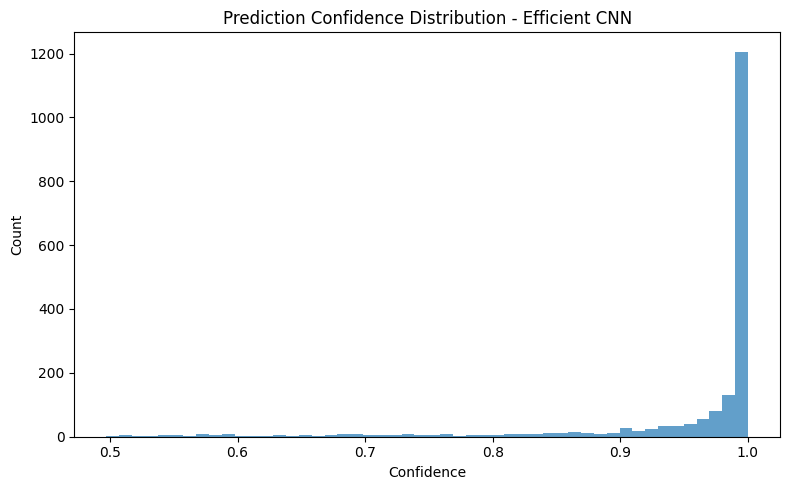

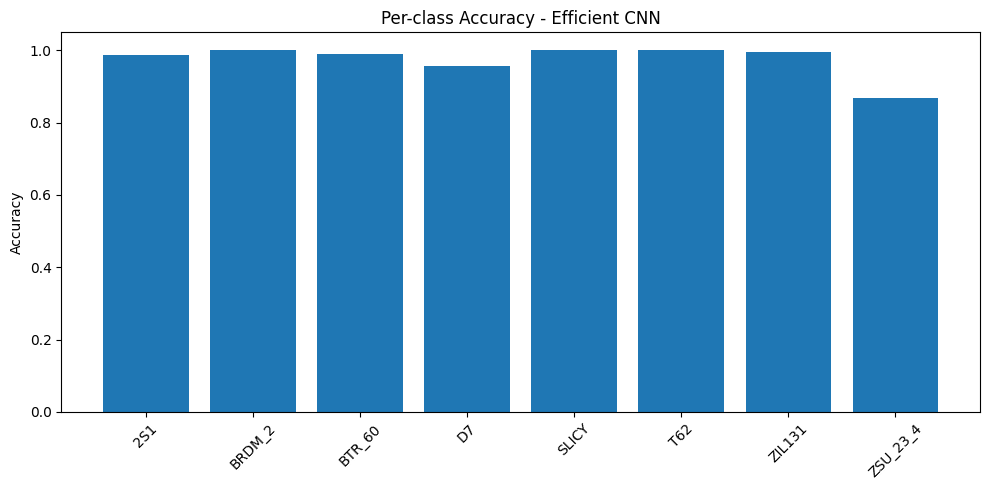

Error evaluating Efficient CNN: name 'test_model_robustness' is not defined

Evaluating MobileNetV2

Analyzing MobileNetV2...


<Figure size 640x480 with 0 Axes>

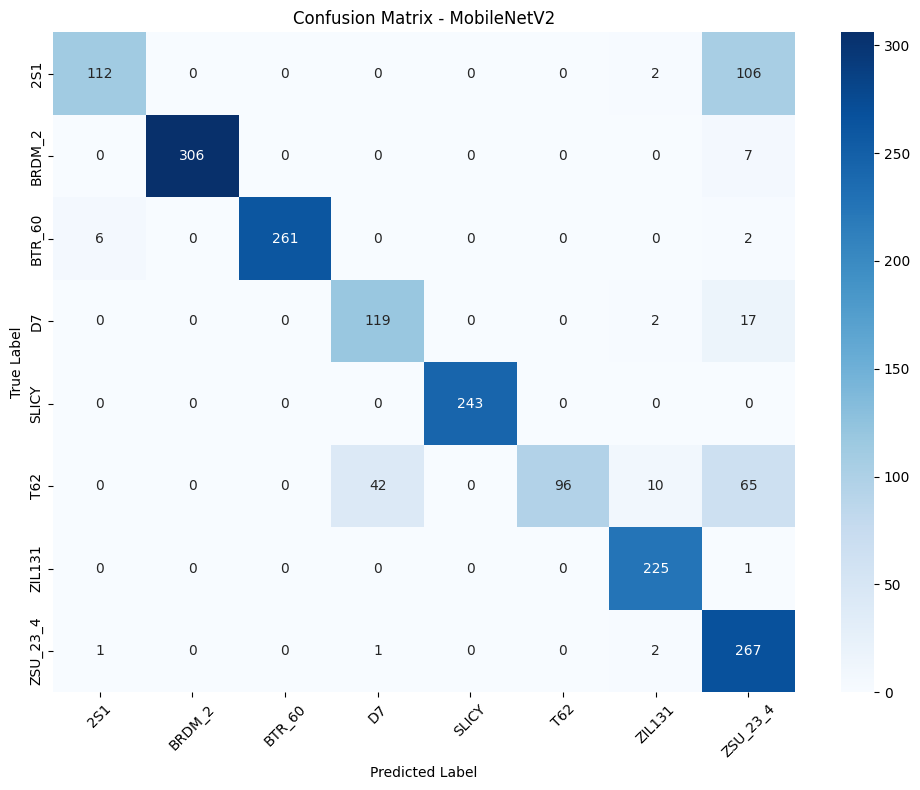


Classification Report - MobileNetV2
              precision    recall  f1-score   support

         2S1       0.94      0.51      0.66       220
      BRDM_2       1.00      0.98      0.99       313
      BTR_60       1.00      0.97      0.98       269
          D7       0.73      0.86      0.79       138
       SLICY       1.00      1.00      1.00       243
         T62       1.00      0.45      0.62       213
      ZIL131       0.93      1.00      0.96       226
    ZSU_23_4       0.57      0.99      0.73       271

    accuracy                           0.86      1893
   macro avg       0.90      0.84      0.84      1893
weighted avg       0.90      0.86      0.86      1893



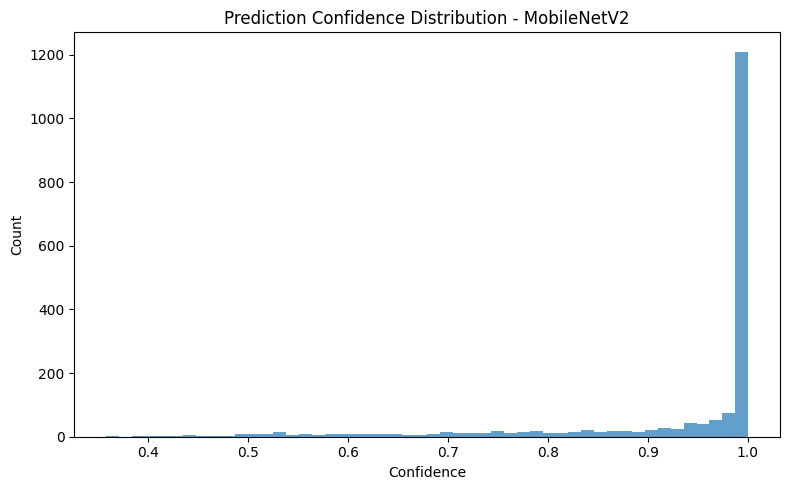

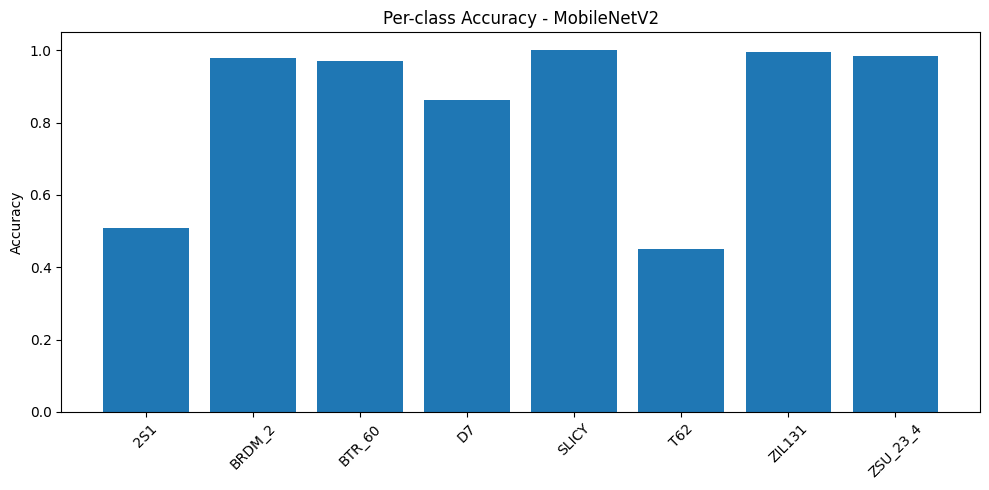

Error evaluating MobileNetV2: name 'test_model_robustness' is not defined

Evaluating ResNet50

Analyzing ResNet50...


<Figure size 640x480 with 0 Axes>

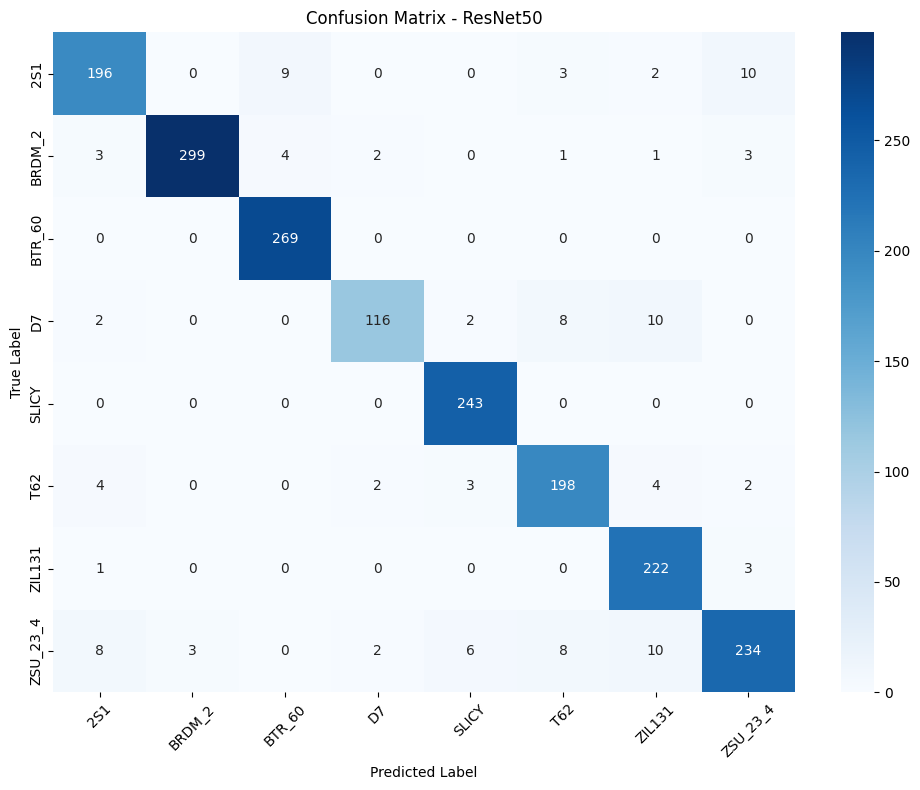


Classification Report - ResNet50
              precision    recall  f1-score   support

         2S1       0.92      0.89      0.90       220
      BRDM_2       0.99      0.96      0.97       313
      BTR_60       0.95      1.00      0.98       269
          D7       0.95      0.84      0.89       138
       SLICY       0.96      1.00      0.98       243
         T62       0.91      0.93      0.92       213
      ZIL131       0.89      0.98      0.93       226
    ZSU_23_4       0.93      0.86      0.89       271

    accuracy                           0.94      1893
   macro avg       0.94      0.93      0.93      1893
weighted avg       0.94      0.94      0.94      1893



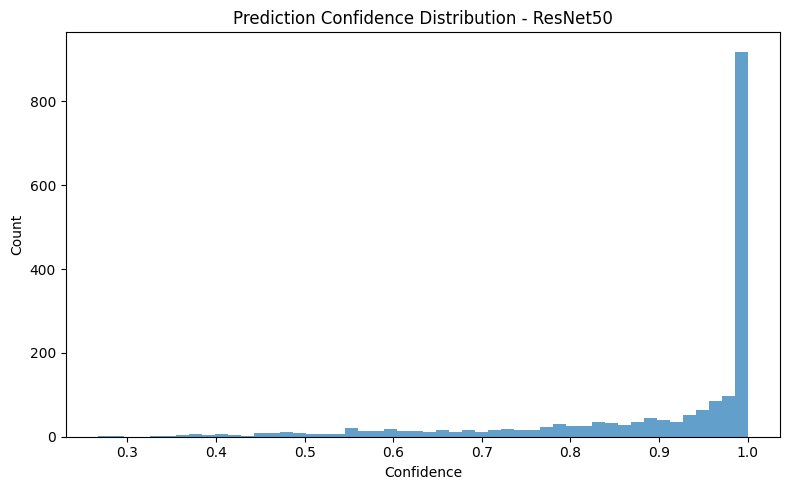

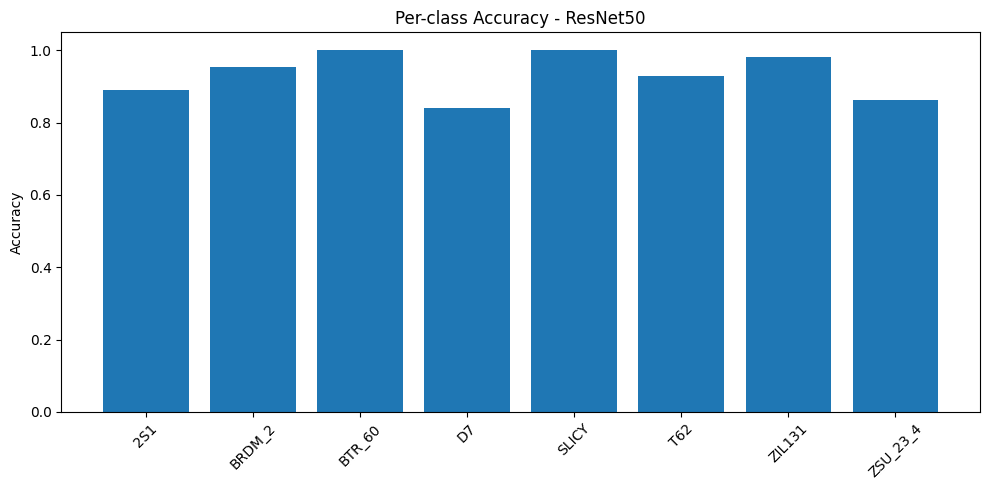

Error evaluating ResNet50: name 'test_model_robustness' is not defined

Model Performance Summary


<Figure size 640x480 with 0 Axes>

In [ ]:
def analyze_all_models(models_to_evaluate, train_histories, directories, class_names):
    """Comprehensive model analysis combining training history and evaluation metrics"""

    plt.figure(figsize=(15, 10))

    plt.subplot(2, 1, 1)
    for model_name, history in train_histories.items():
        epochs = range(1, len(history['accuracy']) + 1)
        plt.plot(epochs, history['accuracy'], '-o', label=f'{model_name} (Train)', alpha=0.7)
        plt.plot(epochs, history['val_accuracy'], '--s', label=f'{model_name} (Val)', alpha=0.7)

    plt.title('Model Accuracy During Training')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)

    plt.subplot(2, 1, 2)
    for model_name, history in train_histories.items():
        epochs = range(1, len(history['loss']) + 1)
        plt.plot(epochs, history['loss'], '-o', label=f'{model_name} (Train)', alpha=0.7)
        plt.plot(epochs, history['val_loss'], '--s', label=f'{model_name} (Val)', alpha=0.7)

    plt.title('Model Loss During Training')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    evaluation_results = {}
    for model_file, model_name in models_to_evaluate:
        print(f"\nEvaluating {model_name}")
        print("=" * 50)

        try:
            model_path = os.path.join(directories['models'], model_file)
            model = tf.keras.models.load_model(model_path)

            results = analyze_model_performance(model, val_ds, model_name, class_names, directories=directories)

            robustness = test_model_robustness(model, val_ds, model_name, class_names, directories=directories)

            evaluation_results[model_name] = {
                'performance': results,
                'robustness': robustness
            }

        except Exception as e:
            print(f"Error evaluating {model_name}: {str(e)}")
            continue

    print("\nModel Performance Summary")
    print("=" * 50)
    for model_name, results in evaluation_results.items():
        perf = results['performance']
        print(f"\n{model_name}:")
        print(f"Overall Accuracy: {perf['accuracy']:.4f}")
        print("Per-class Accuracies:")
        for class_name, acc in zip(class_names, perf['class_accuracies']):
            print(f"  {class_name}: {acc:.4f}")
        print(f"Average Confidence: {np.mean(perf['confidences']):.4f}")

    return evaluation_results

train_histories = {
    'Baseline CNN': baseline_results['history'],
    'Deeper CNN': deeper_results['history'],
    'Efficient CNN': efficient_results['history'],
    'MobileNetV2': mobilenet_results['history'],
    'ResNet50': resnet_results['history']
}

models_to_evaluate = [
    ('baseline_cnn.keras', 'Baseline CNN'),
    ('deeper_cnn.keras', 'Deeper CNN'),
    ('efficient_cnn.keras', 'Efficient CNN'),
    ('mobilenetv2.keras', 'MobileNetV2'),
    ('resnet50.keras', 'ResNet50')
]

evaluation_results = analyze_all_models(models_to_evaluate, train_histories, directories, class_names)

In [ ]:

def test_model_robustness(model, val_ds, model_name, class_names, n_samples=8, directories=None):
    """Test model performance under various perturbations"""
    @tf.function
    def apply_perturbations(image):
        """Optimized perturbation function"""
        perturbations = {
            'original': image,
            'noise': tf.clip_by_value(
                image + tf.random.normal(tf.shape(image), mean=0, stddev=0.1),
                0, 1
            ),
            'brightness': tf.clip_by_value(
                tf.image.adjust_brightness(image, delta=0.2),
                0, 1
            ),
            'contrast': tf.clip_by_value(
                tf.image.adjust_contrast(image, 2.0),
                0, 1
            ),
            'rotation': tf.image.rot90(image)
        }
        return perturbations

    results = {}

    images, labels = next(iter(val_ds.take(1)))
    images = images[:n_samples]
    labels = labels[:n_samples]

    for i, image in enumerate(images):
        perturbed = apply_perturbations(image)

        plt.figure(figsize=(15, 3))
        for idx, (name, perturbed_image) in enumerate(perturbed.items()):
            plt.subplot(1, 5, idx + 1)
            plt.imshow(perturbed_image.numpy())

            pred = model.predict(tf.expand_dims(perturbed_image, 0), verbose=0)
            pred_class = class_names[np.argmax(pred[0])]
            confidence = np.max(pred[0]) * 100

            plt.title(f'{name}\nPred: {pred_class}\nConf: {confidence:.1f}%')
            plt.axis('off')

        plt.tight_layout()

        if directories:
            plots_dir = os.path.join(directories['results'], 'robustness_plots')
            os.makedirs(plots_dir, exist_ok=True)
            plt.savefig(os.path.join(plots_dir, f'{model_name.lower()}_robustness_{i}.png'))

        plt.show()

        if i >= n_samples - 1:
            break

    return results

def evaluate_single_model(model, model_name, val_ds, class_names, directories=None):
    """Run comprehensive evaluation for a single model"""
    print(f"\n{'='*50}")
    print(f"Evaluating {model_name}...")
    print(f"{'='*50}")

    performance_results = analyze_model_performance(
        model, val_ds, model_name, class_names, directories=directories
    )

    robustness_results = test_model_robustness(
        model, val_ds, model_name, class_names, directories=directories
    )

    results = {
        'performance': performance_results,
        'robustness': robustness_results
    }

    if directories:
        eval_path = os.path.join(directories['results'], f'{model_name.lower()}_evaluation.pkl')
        with open(eval_path, 'wb') as f:
            pickle.dump(results, f)

    return results

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'adam', because it has 42 variables whereas the saved optimizer has 46 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))



Evaluating Baseline CNN...

Analyzing Baseline CNN...


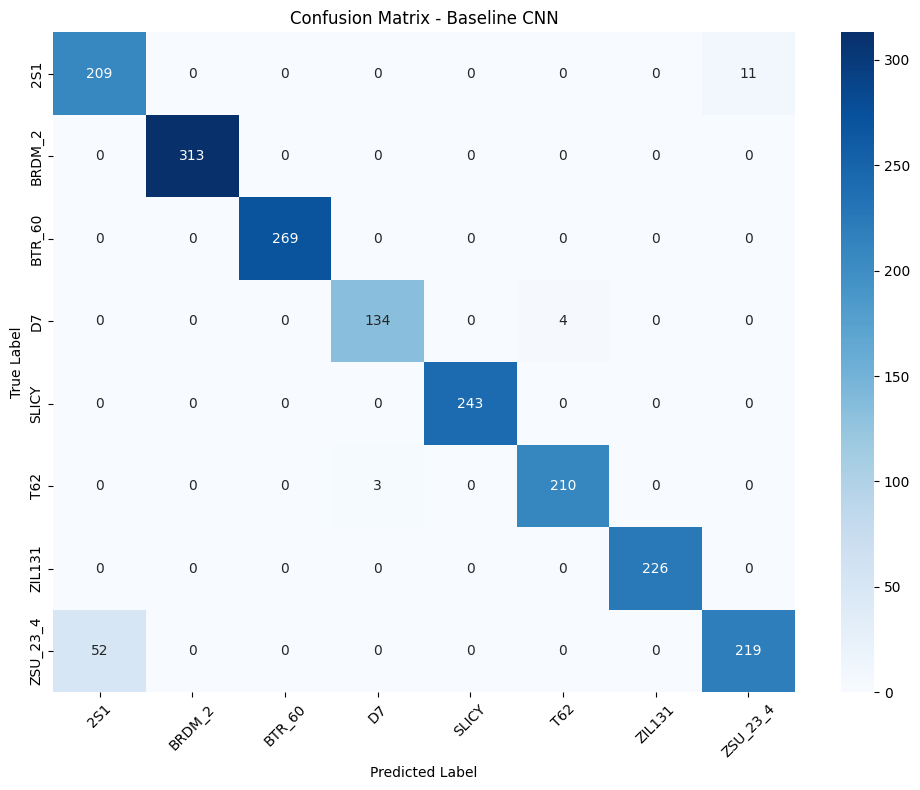


Classification Report - Baseline CNN
              precision    recall  f1-score   support

         2S1       0.80      0.95      0.87       220
      BRDM_2       1.00      1.00      1.00       313
      BTR_60       1.00      1.00      1.00       269
          D7       0.98      0.97      0.97       138
       SLICY       1.00      1.00      1.00       243
         T62       0.98      0.99      0.98       213
      ZIL131       1.00      1.00      1.00       226
    ZSU_23_4       0.95      0.81      0.87       271

    accuracy                           0.96      1893
   macro avg       0.96      0.96      0.96      1893
weighted avg       0.97      0.96      0.96      1893



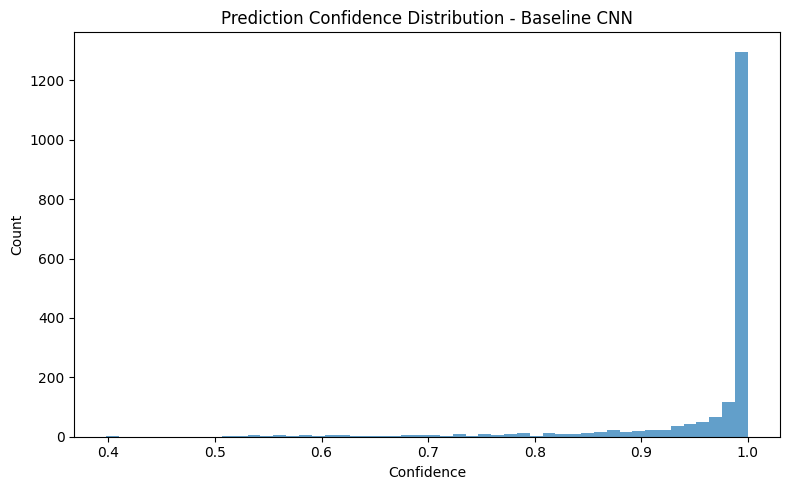

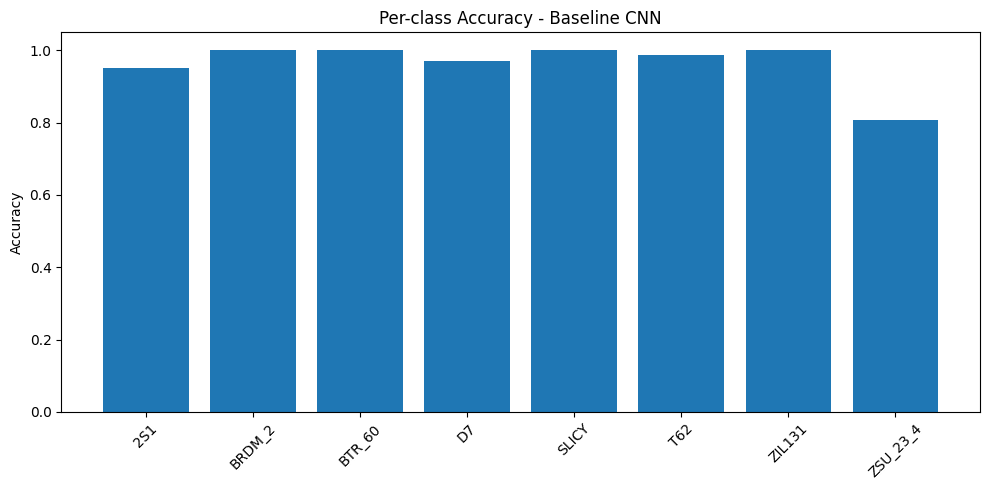

<Figure size 640x480 with 0 Axes>

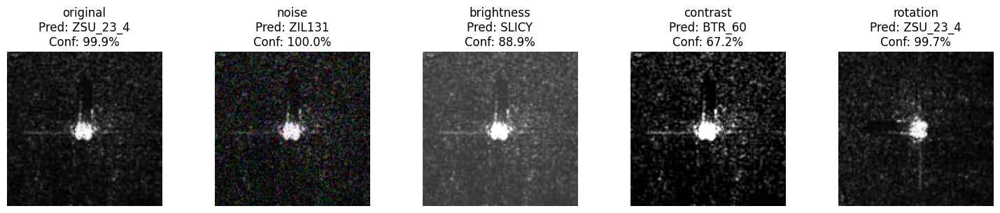

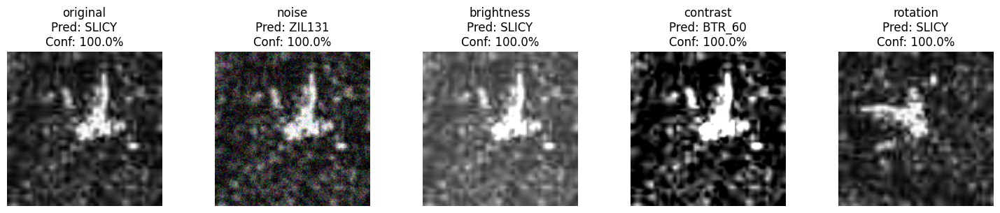

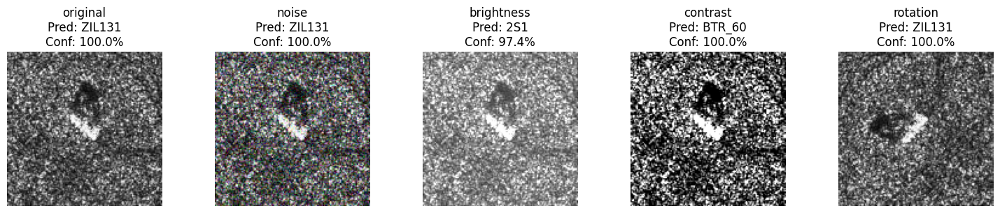

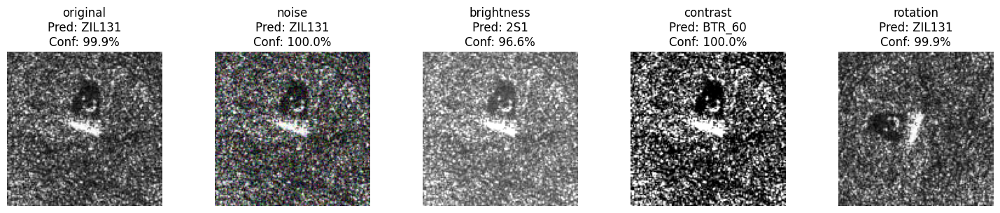

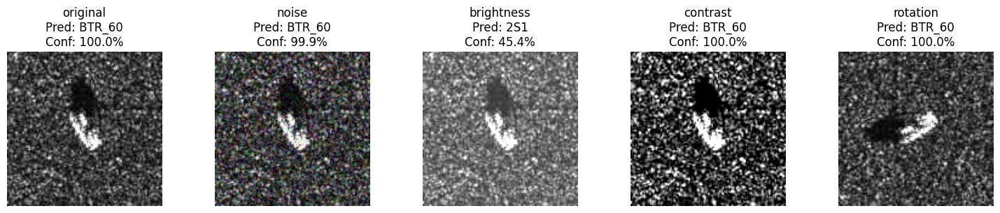

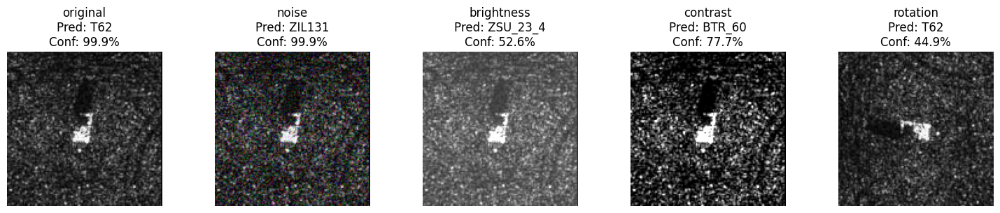

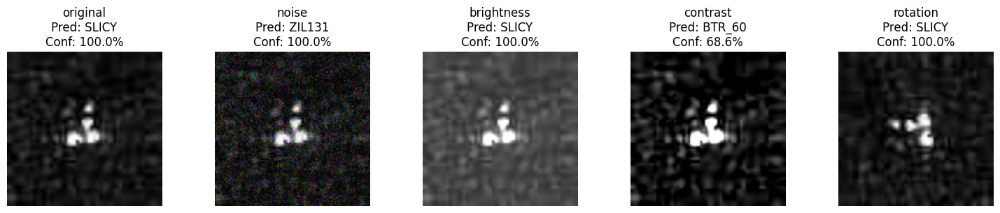

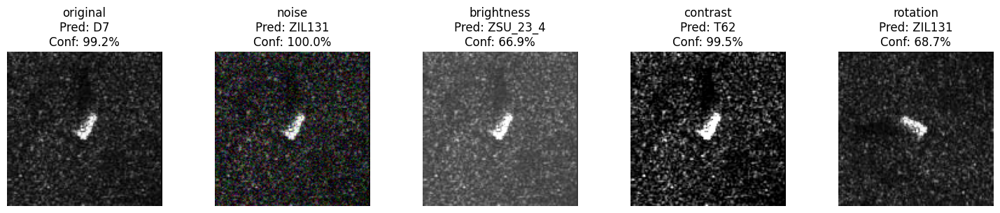


Evaluating Deeper CNN...

Analyzing Deeper CNN...


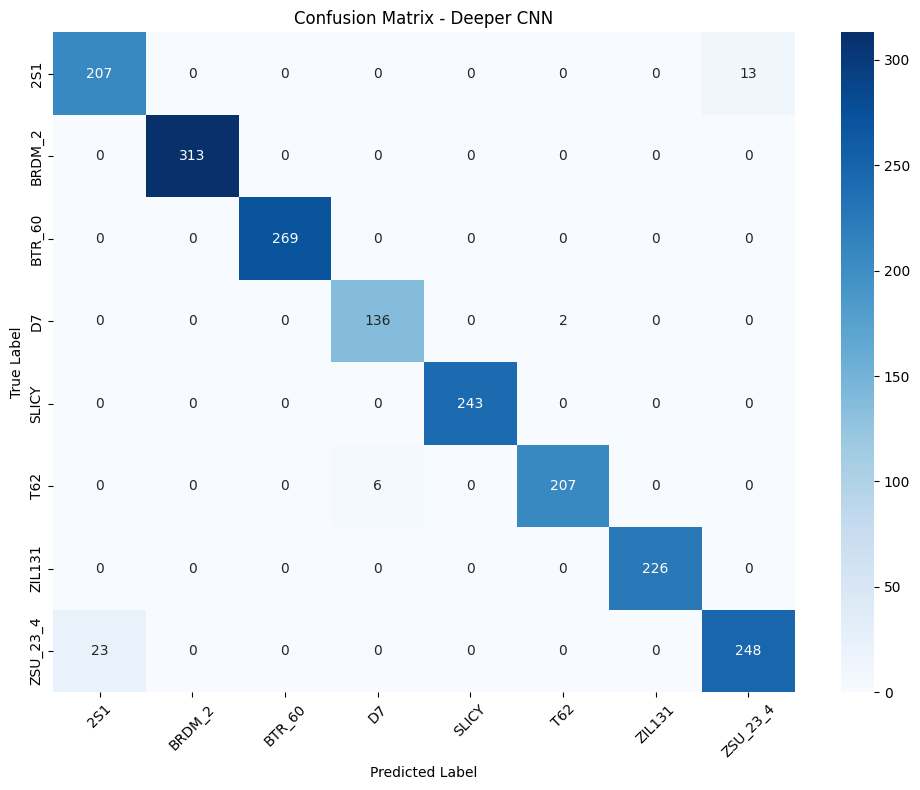


Classification Report - Deeper CNN
              precision    recall  f1-score   support

         2S1       0.90      0.94      0.92       220
      BRDM_2       1.00      1.00      1.00       313
      BTR_60       1.00      1.00      1.00       269
          D7       0.96      0.99      0.97       138
       SLICY       1.00      1.00      1.00       243
         T62       0.99      0.97      0.98       213
      ZIL131       1.00      1.00      1.00       226
    ZSU_23_4       0.95      0.92      0.93       271

    accuracy                           0.98      1893
   macro avg       0.97      0.98      0.98      1893
weighted avg       0.98      0.98      0.98      1893



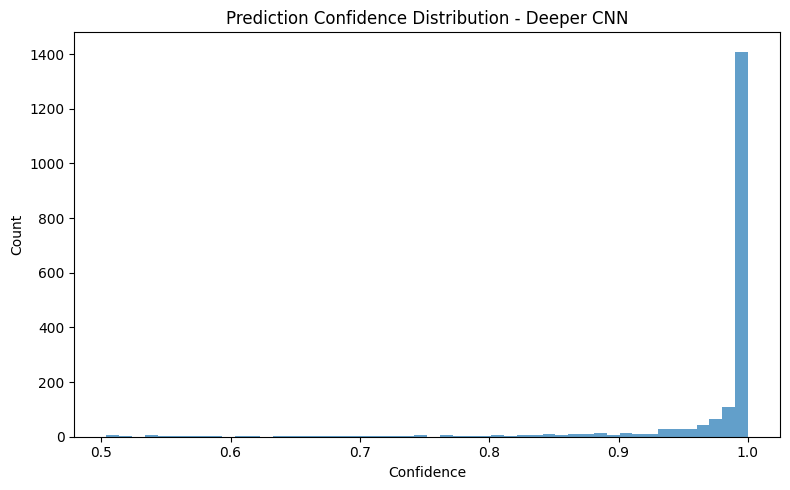

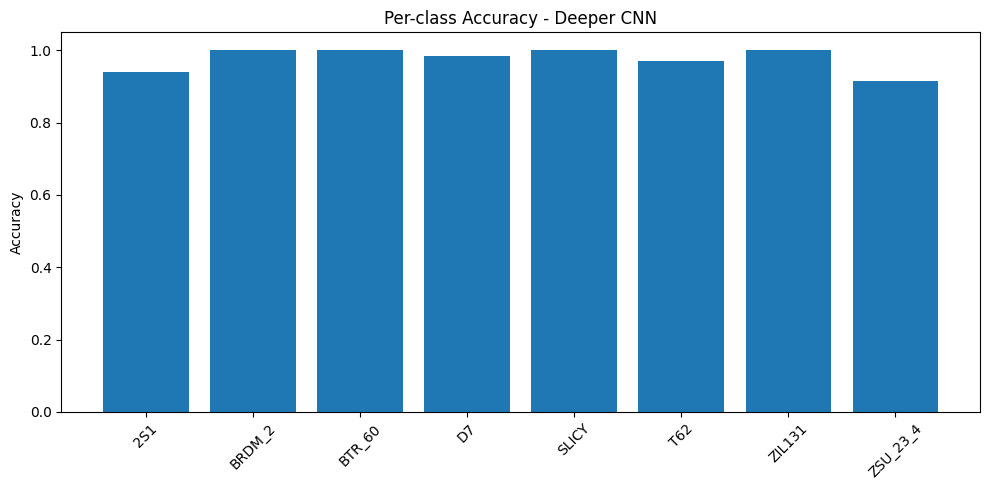

<Figure size 640x480 with 0 Axes>

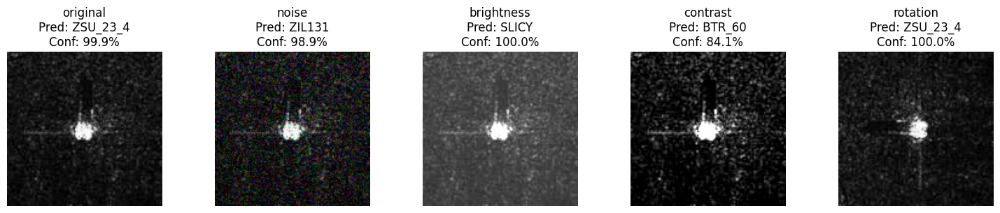

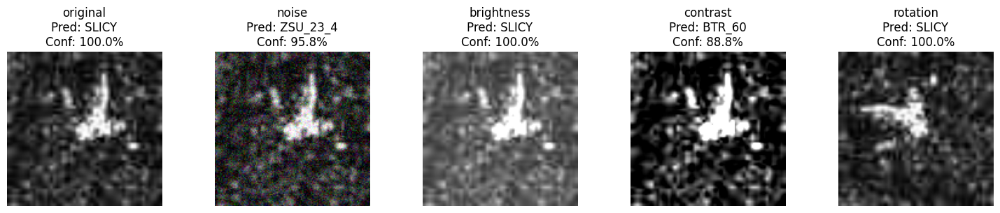

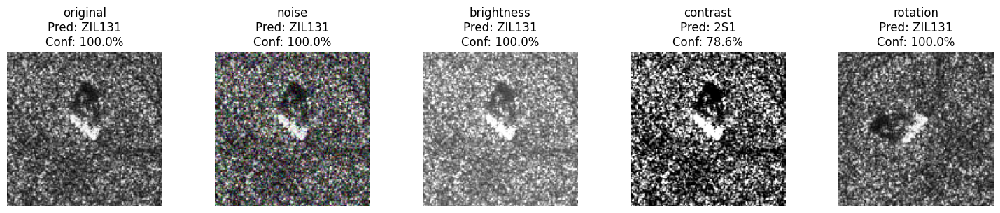

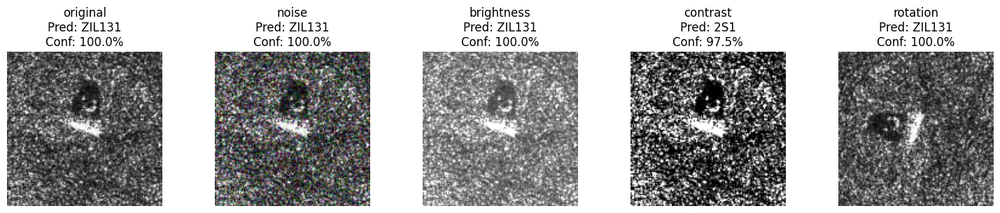

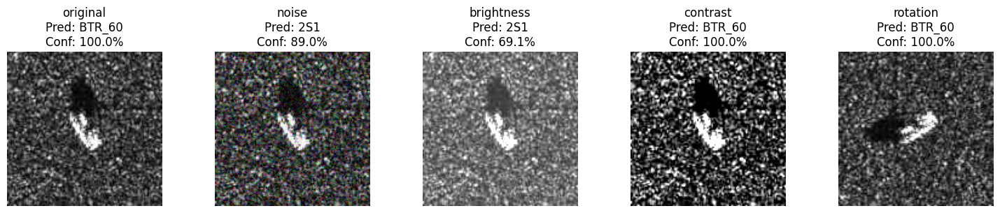

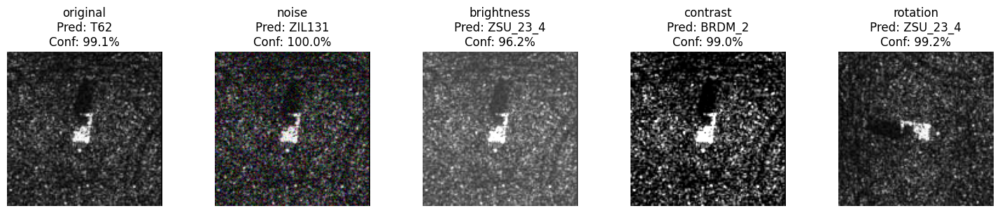

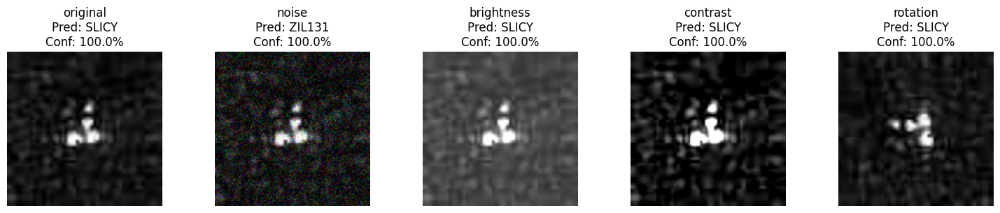

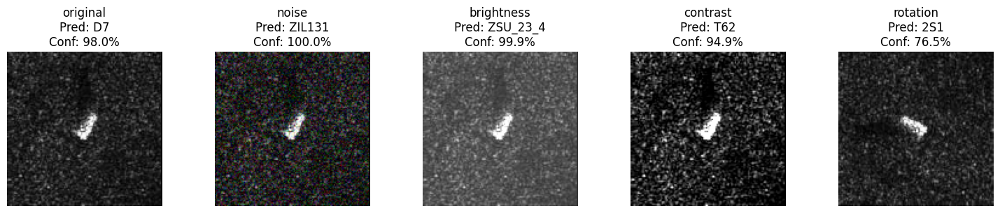


Evaluating Efficient CNN...

Analyzing Efficient CNN...


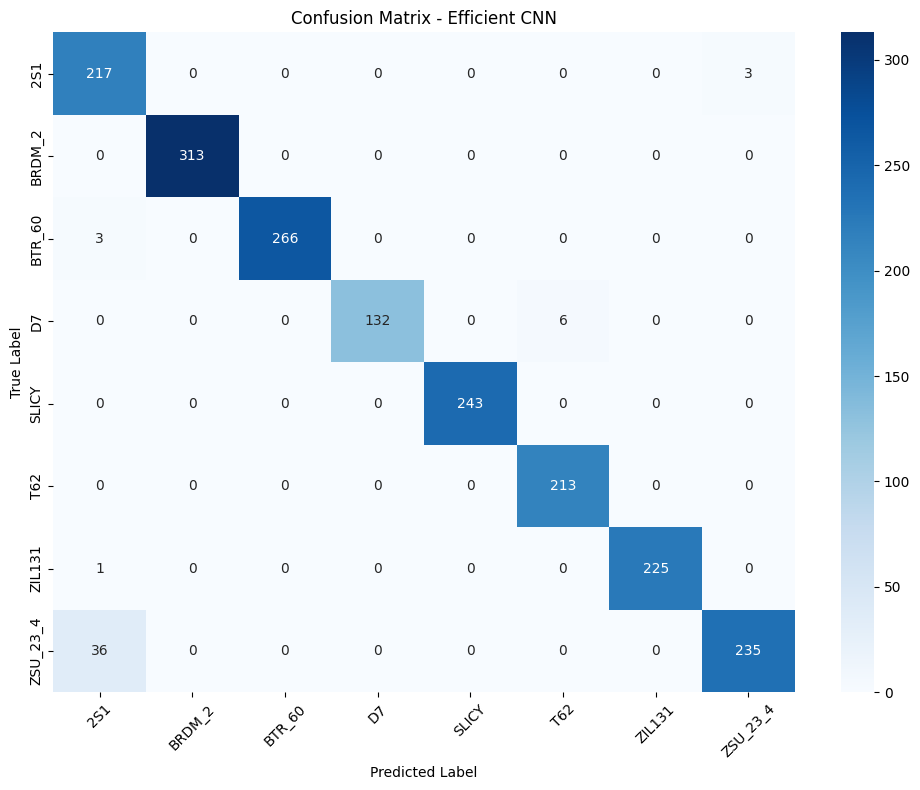


Classification Report - Efficient CNN
              precision    recall  f1-score   support

         2S1       0.84      0.99      0.91       220
      BRDM_2       1.00      1.00      1.00       313
      BTR_60       1.00      0.99      0.99       269
          D7       1.00      0.96      0.98       138
       SLICY       1.00      1.00      1.00       243
         T62       0.97      1.00      0.99       213
      ZIL131       1.00      1.00      1.00       226
    ZSU_23_4       0.99      0.87      0.92       271

    accuracy                           0.97      1893
   macro avg       0.98      0.97      0.97      1893
weighted avg       0.98      0.97      0.97      1893



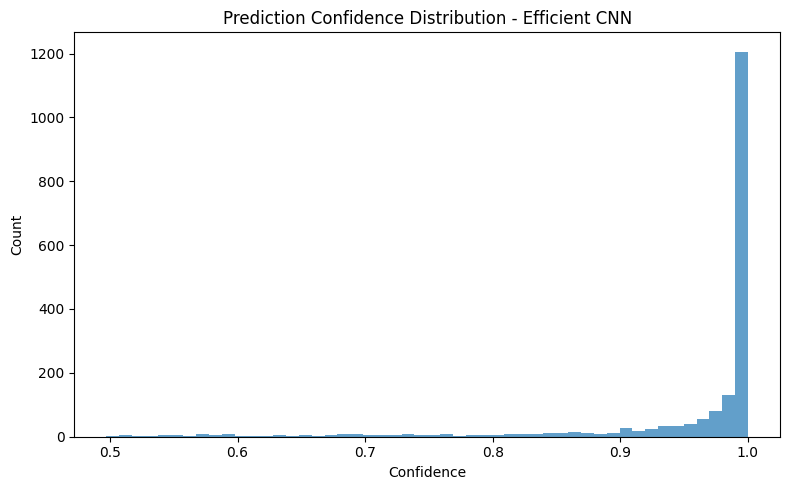

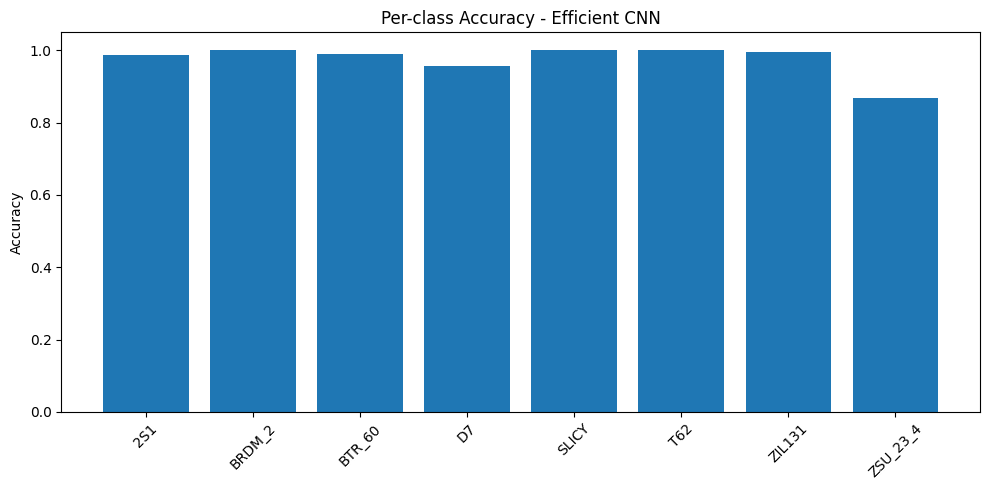

<Figure size 640x480 with 0 Axes>

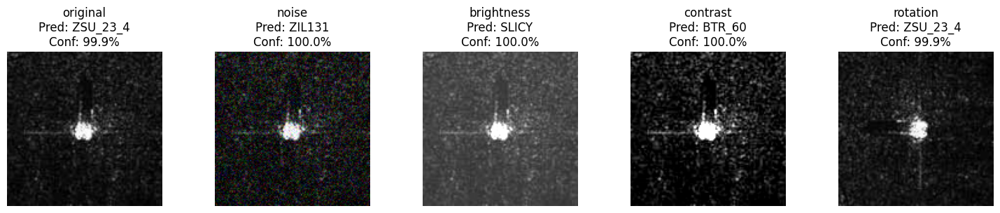

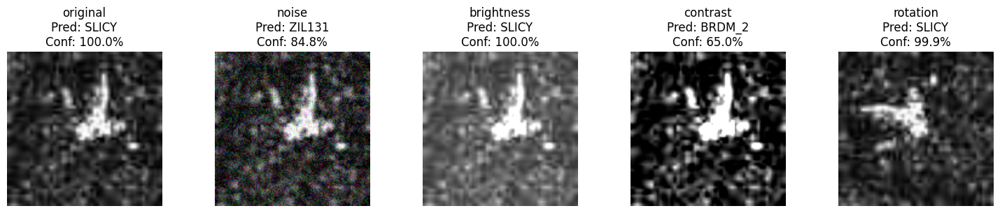

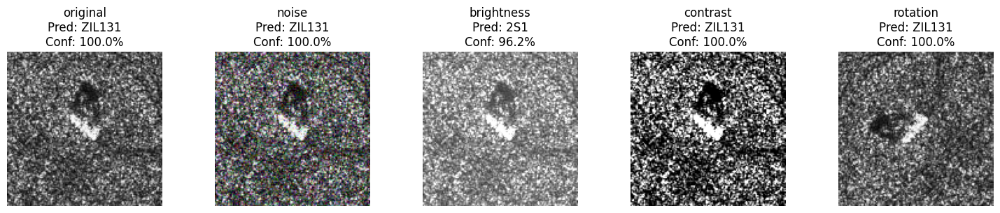

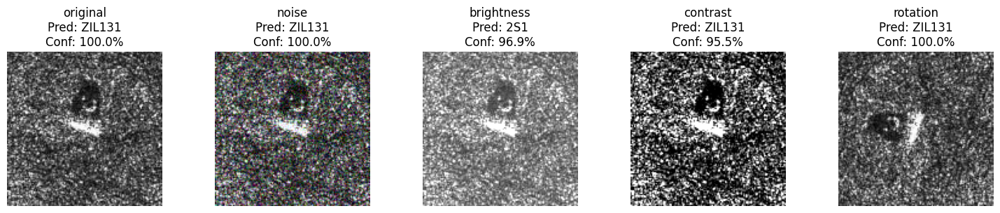

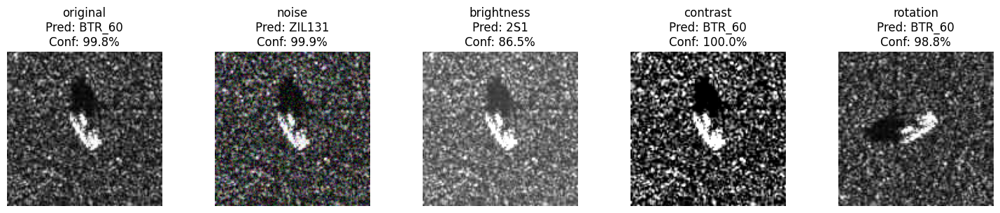

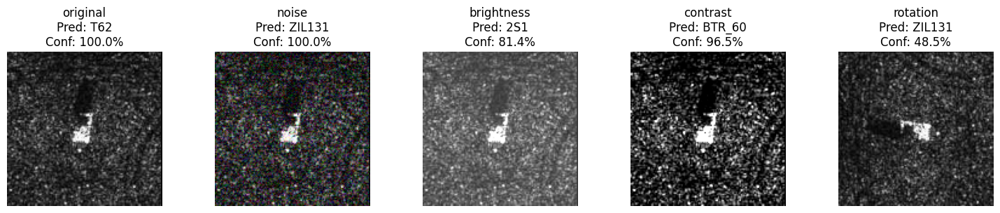

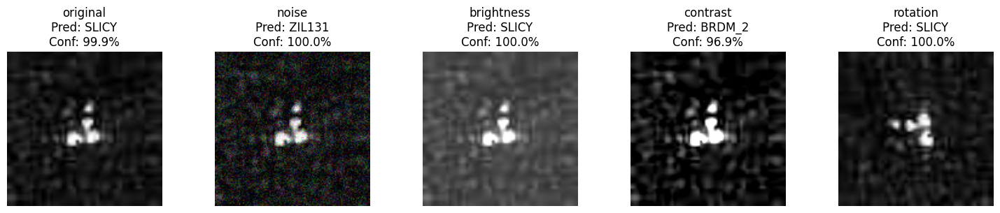

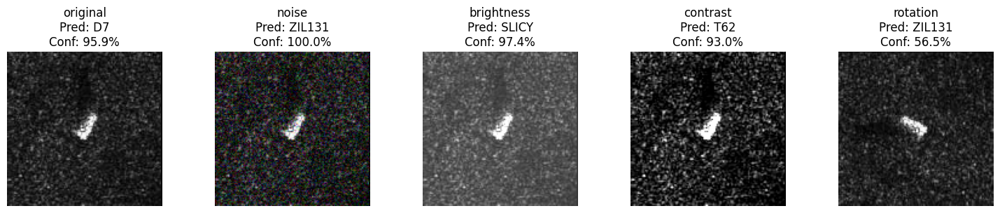


Evaluating MobileNetV2...

Analyzing MobileNetV2...


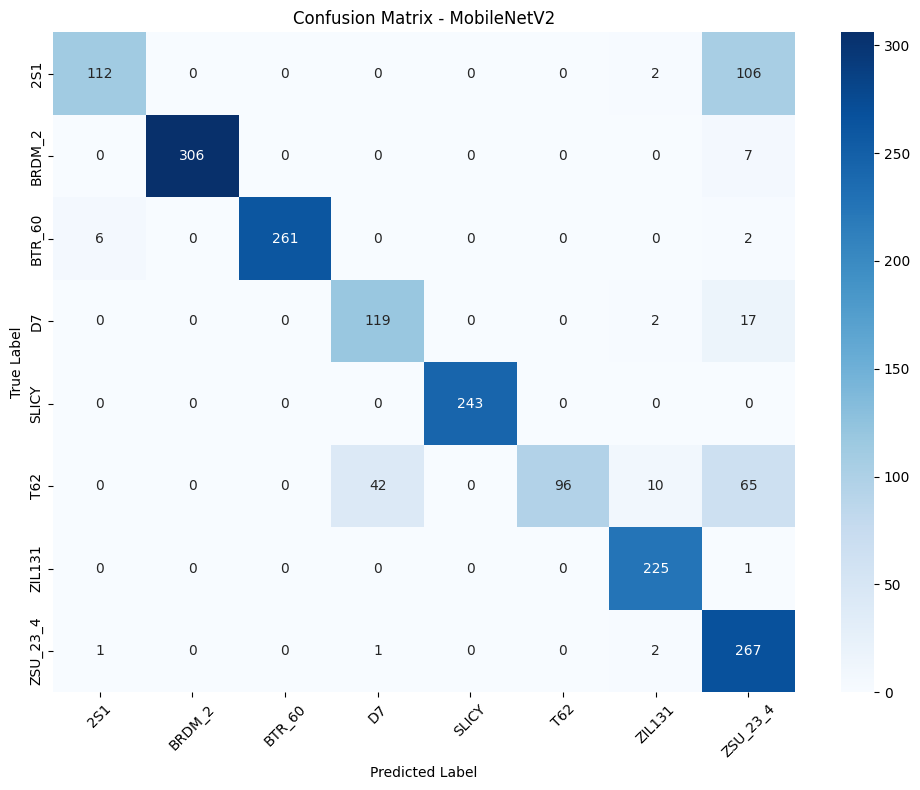


Classification Report - MobileNetV2
              precision    recall  f1-score   support

         2S1       0.94      0.51      0.66       220
      BRDM_2       1.00      0.98      0.99       313
      BTR_60       1.00      0.97      0.98       269
          D7       0.73      0.86      0.79       138
       SLICY       1.00      1.00      1.00       243
         T62       1.00      0.45      0.62       213
      ZIL131       0.93      1.00      0.96       226
    ZSU_23_4       0.57      0.99      0.73       271

    accuracy                           0.86      1893
   macro avg       0.90      0.84      0.84      1893
weighted avg       0.90      0.86      0.86      1893



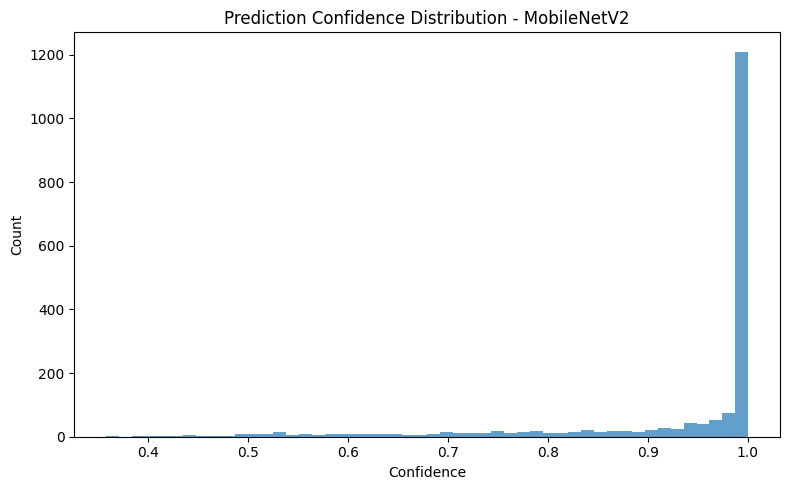

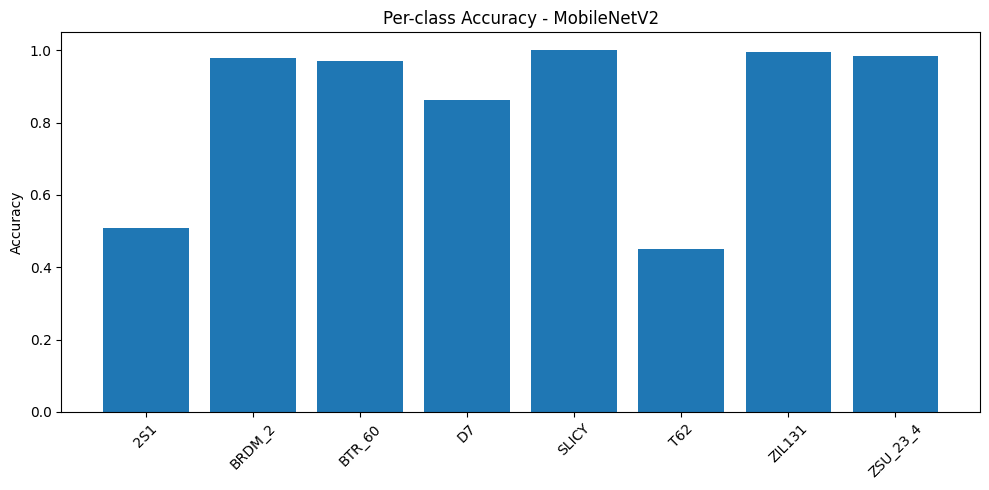

<Figure size 640x480 with 0 Axes>

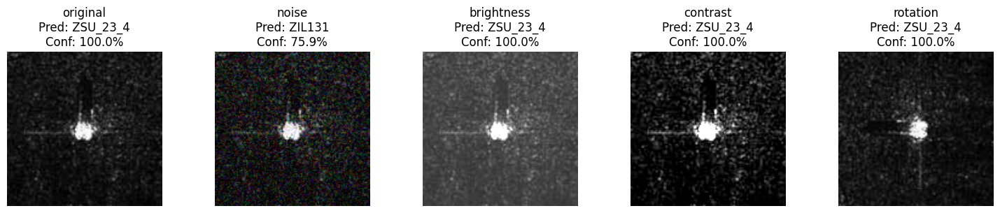

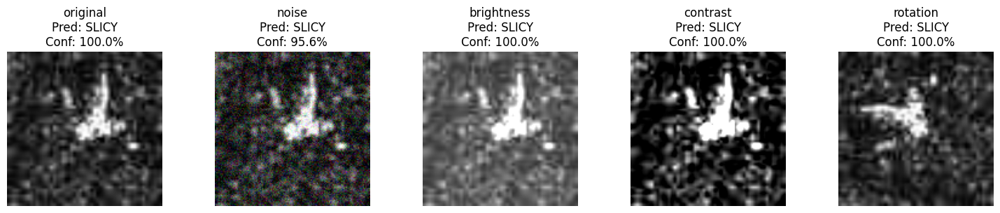

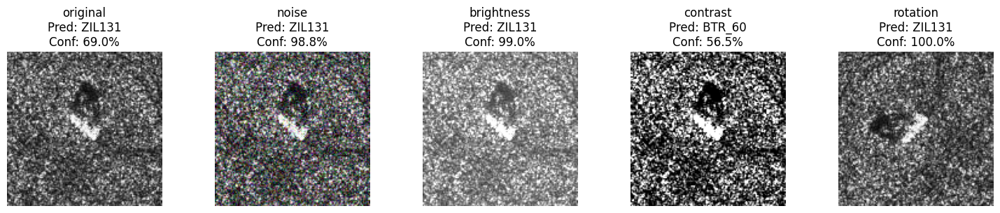

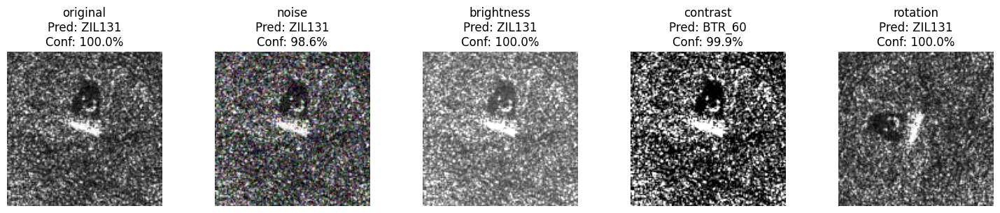

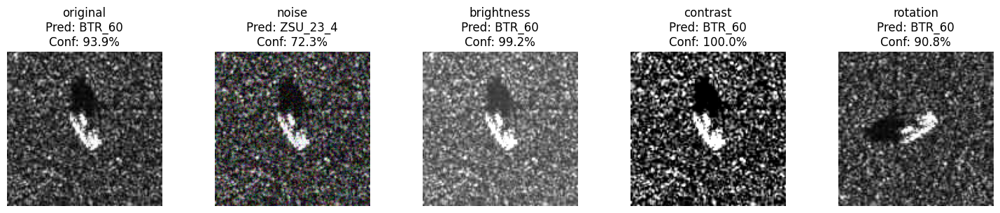

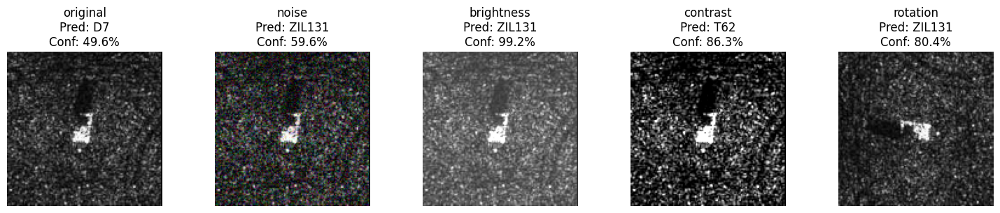

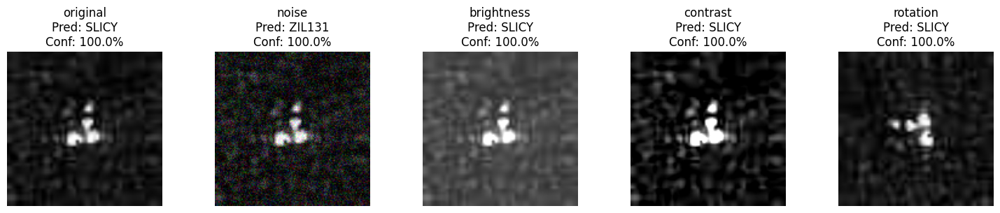

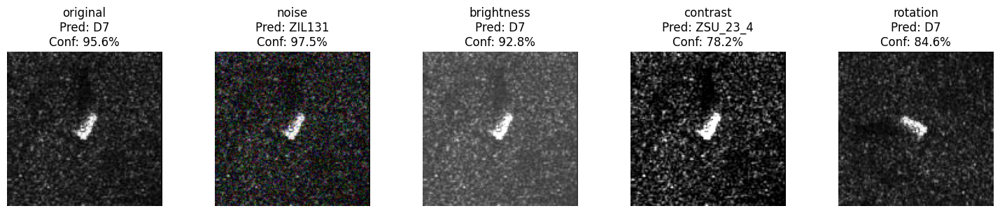


Evaluating ResNet50...

Analyzing ResNet50...


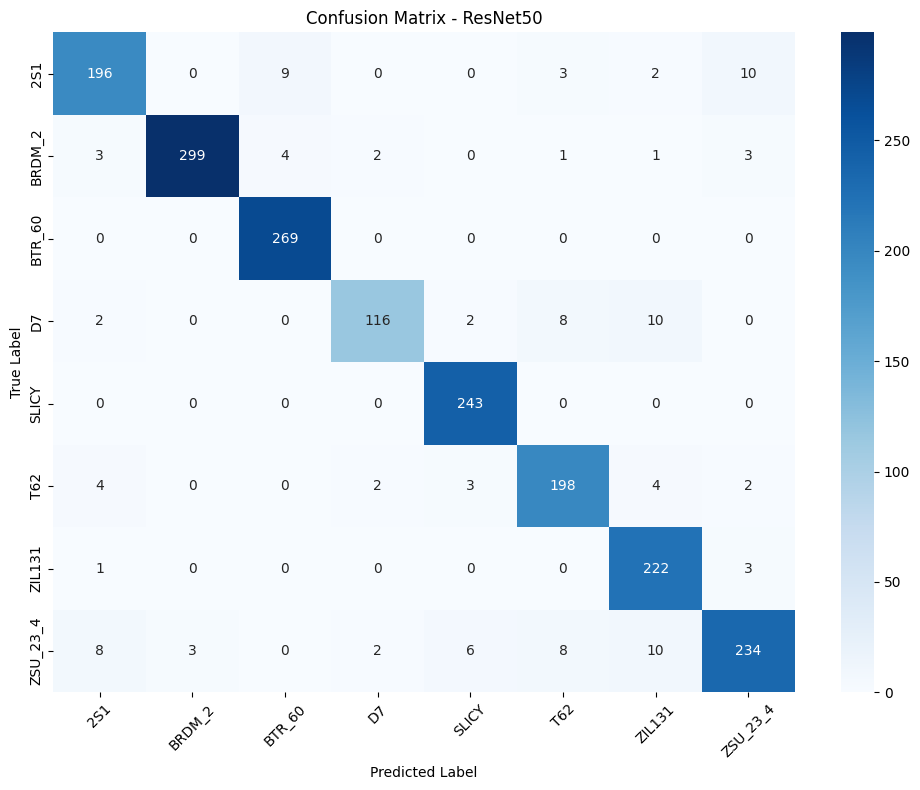


Classification Report - ResNet50
              precision    recall  f1-score   support

         2S1       0.92      0.89      0.90       220
      BRDM_2       0.99      0.96      0.97       313
      BTR_60       0.95      1.00      0.98       269
          D7       0.95      0.84      0.89       138
       SLICY       0.96      1.00      0.98       243
         T62       0.91      0.93      0.92       213
      ZIL131       0.89      0.98      0.93       226
    ZSU_23_4       0.93      0.86      0.89       271

    accuracy                           0.94      1893
   macro avg       0.94      0.93      0.93      1893
weighted avg       0.94      0.94      0.94      1893



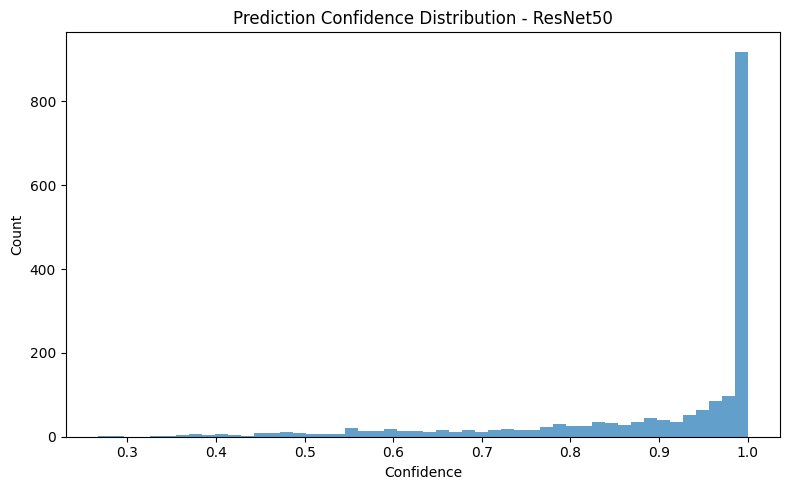

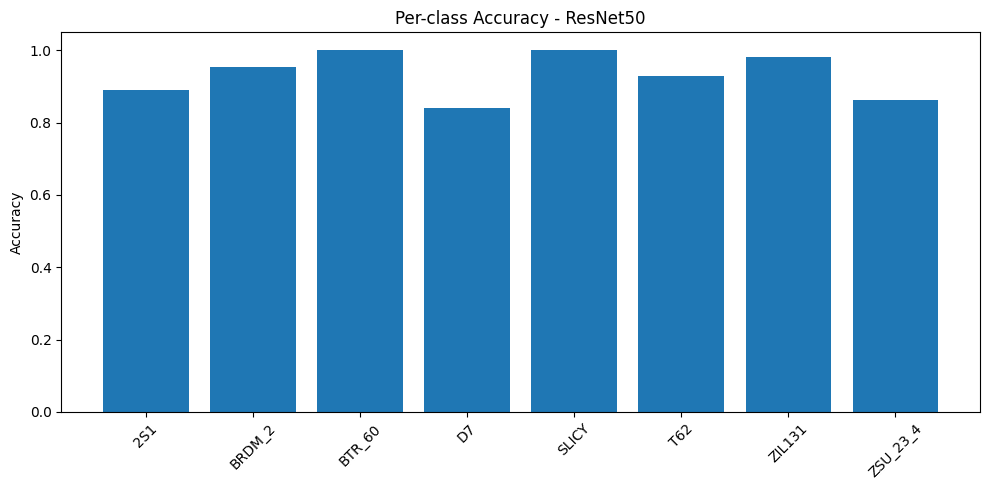

<Figure size 640x480 with 0 Axes>

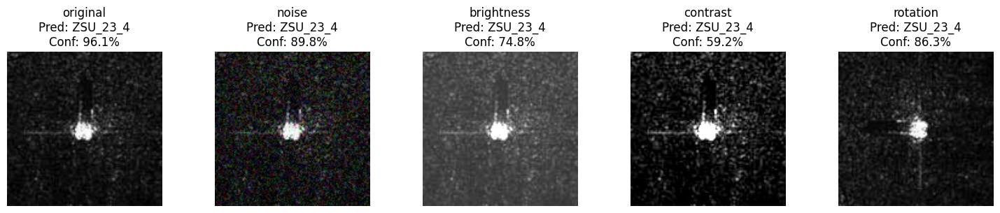

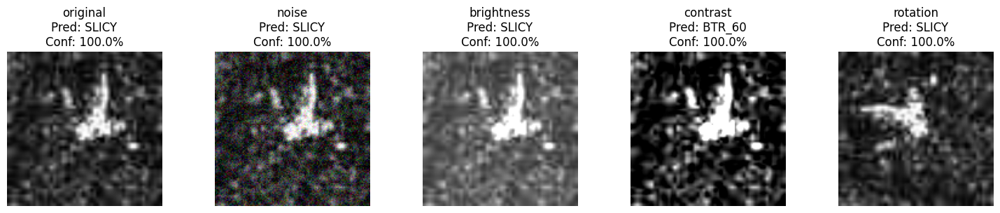

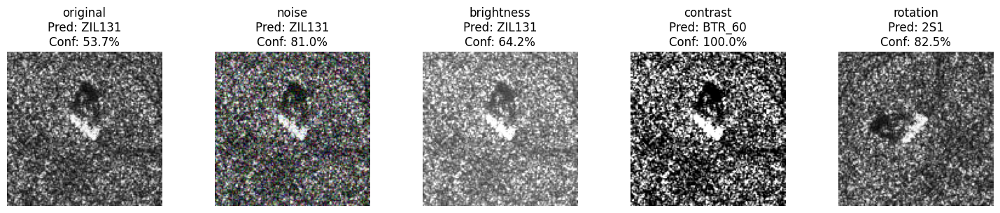

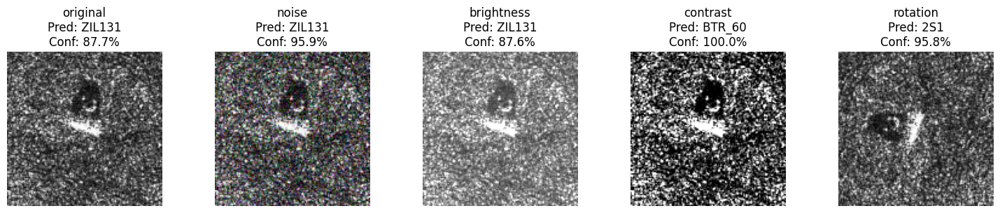

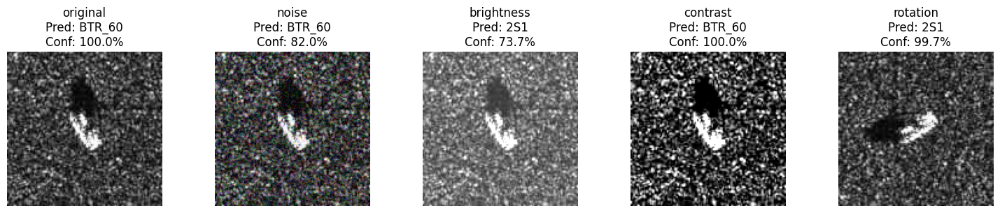

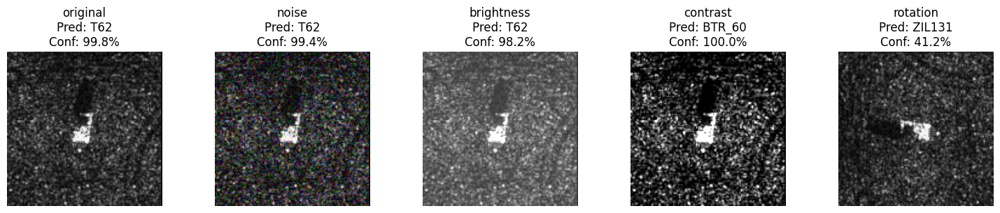

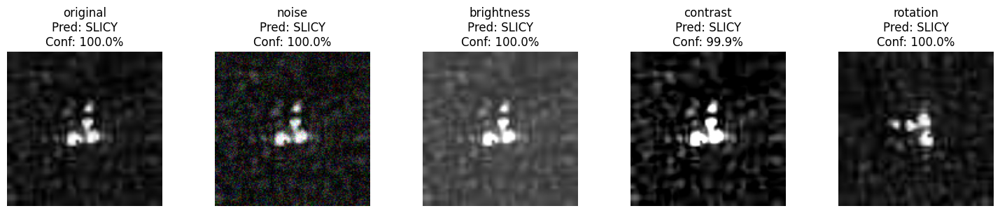

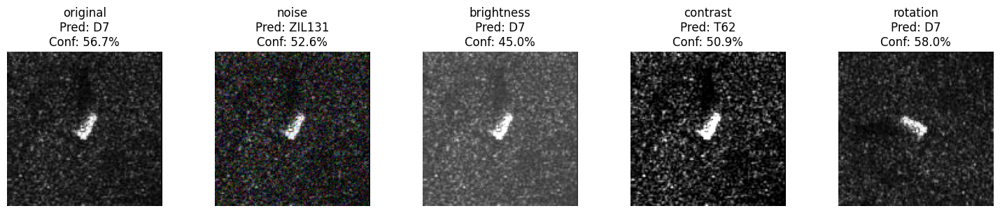

In [ ]:
models_to_evaluate = [
    ('baseline_cnn.keras', 'Baseline CNN'),
    ('deeper_cnn.keras', 'Deeper CNN'),
    ('efficient_cnn.keras', 'Efficient CNN'),
    ('mobilenetv2.keras', 'MobileNetV2'),
    ('resnet50.keras', 'ResNet50')
]

for model_file, model_name in models_to_evaluate:
    model_path = os.path.join(directories['models'], model_file)
    try:
        model = tf.keras.models.load_model(model_path)
        results = evaluate_single_model(model, model_name, val_ds, class_names, directories)
    except Exception as e:
        print(f"Error evaluating {model_name}: {str(e)}")
        continue

In [ ]:
class AdversarialAttacks:
    """Optimized implementation of adversarial attacks with proper type handling"""
    def __init__(self, model):
        self.model = model
        self.loss_fn = tf.keras.losses.SparseCategoricalCrossentropy()

    @tf.function
    def fgsm_attack(self, images, labels, epsilon):
        """Fast Gradient Sign Method (FGSM) attack with explicit type casting"""
        images = tf.cast(images, tf.float32)
        labels = tf.cast(labels, tf.int64)

        with tf.GradientTape() as tape:
            tape.watch(images)
            predictions = self.model(images, training=False)
            loss = self.loss_fn(labels, predictions)

        gradients = tape.gradient(loss, images)
        gradients = tf.cast(gradients, tf.float32)
        perturbation = epsilon * tf.sign(gradients)

        perturbed_images = tf.clip_by_value(
            images + perturbation,
            clip_value_min=0.0,
            clip_value_max=1.0
        )
        return perturbed_images

    @tf.function
    def pgd_attack(self, images, labels, epsilon, alpha, num_iter):
        """Projected Gradient Descent (PGD) attack with type safety"""
        images = tf.cast(images, tf.float32)
        labels = tf.cast(labels, tf.int64)

        images_adv = images + tf.random.uniform(tf.shape(images), -epsilon, epsilon)
        images_adv = tf.clip_by_value(images_adv, 0.0, 1.0)

        for _ in tf.range(num_iter):
            with tf.GradientTape() as tape:
                tape.watch(images_adv)
                predictions = self.model(images_adv, training=False)
                loss = self.loss_fn(labels, predictions)

            gradients = tape.gradient(loss, images_adv)
            gradients = tf.cast(gradients, tf.float32)
            perturbation = alpha * tf.sign(gradients)

            images_adv = tf.clip_by_value(
                images_adv + perturbation,
                images - epsilon,
                images + epsilon
            )
            images_adv = tf.clip_by_value(images_adv, 0.0, 1.0)

        return images_adv

def evaluate_clean_accuracy(model, dataset):
    """Evaluate clean accuracy with proper type handling"""
    correct = tf.constant(0, dtype=tf.int64)
    total = tf.constant(0, dtype=tf.int64)

    for images, labels in tqdm(dataset, desc="Evaluating clean accuracy"):
        images = tf.cast(images, tf.float32)
        labels = tf.cast(labels, tf.int64)

        predictions = model(images, training=False)
        predictions = tf.cast(predictions, tf.float32)
        pred_labels = tf.cast(tf.argmax(predictions, axis=1), tf.int64)

        correct += tf.reduce_sum(tf.cast(tf.equal(pred_labels, labels), tf.int64))
        total += tf.cast(tf.shape(labels)[0], tf.int64)

    return float(tf.cast(correct, tf.float32) / tf.cast(total, tf.float32))

def evaluate_attack(model, val_ds, attack, attack_type, params, max_batches):
    """Evaluate model under attack with proper type handling and NaN prevention"""
    total_correct = tf.constant(0, dtype=tf.int64)
    total_samples = tf.constant(0, dtype=tf.int64)
    total_confidence = tf.constant(0.0, dtype=tf.float32)

    attack_fn = getattr(attack, f'{attack_type}_attack')

    for images, labels in tqdm(val_ds.take(max_batches), desc=f"Testing {attack_type}"):
        images = tf.cast(images, tf.float32)
        labels = tf.cast(labels, tf.int64)

        adv_images = attack_fn(images, labels, **params)

        predictions = model(tf.cast(adv_images, model.dtype), training=False)
        predictions = tf.cast(predictions, tf.float32)

        predictions = tf.clip_by_value(predictions, 1e-7, 1.0)
        predictions = predictions / tf.reduce_sum(predictions, axis=1, keepdims=True)

        pred_labels = tf.cast(tf.argmax(predictions, axis=1), tf.int64)
        correct = tf.cast(tf.equal(pred_labels, labels), tf.int64)

        total_correct += tf.reduce_sum(correct)
        total_samples += tf.cast(tf.shape(labels)[0], tf.int64)

        confidence_values = tf.reduce_max(predictions, axis=1)
        confidence_values = tf.where(
            tf.math.is_finite(confidence_values),
            confidence_values,
            tf.zeros_like(confidence_values)
        )
        total_confidence += tf.reduce_sum(confidence_values)

    total_samples_float = tf.cast(total_samples, tf.float32)
    accuracy = float(tf.cast(total_correct, tf.float32) / total_samples_float)
    avg_confidence = float(total_confidence / total_samples_float)

    if not np.isfinite(avg_confidence):
        avg_confidence = 0.0

    return {
        'accuracy': accuracy,
        'confidence': avg_confidence,
        'total_samples': int(total_samples)
    }

def evaluate_model_robustness(model, val_ds, model_name, directories, max_batches=50):
    """Main evaluation function with additional error checking"""
    print(f"\nEvaluating {model_name}")
    print("=" * 50)

    attack_configs = {
        'fgsm': [
            {'epsilon': 0.01},
            {'epsilon': 0.05},
            {'epsilon': 0.1}
        ],
        'pgd': [
            {'epsilon': 0.01, 'alpha': 0.002, 'num_iter': 7},
            {'epsilon': 0.05, 'alpha': 0.01, 'num_iter': 7},
            {'epsilon': 0.1, 'alpha': 0.02, 'num_iter': 7}
        ]
    }

    attack = AdversarialAttacks(model)
    results = {'model_name': model_name, 'fgsm': [], 'pgd': []}

    clean_accuracy = evaluate_clean_accuracy(model, val_ds.take(max_batches))
    print(f"\nClean Accuracy: {clean_accuracy:.4f}")
    results['clean_accuracy'] = clean_accuracy

    for attack_type, configs in attack_configs.items():
        print(f"\nEvaluating {attack_type.upper()} attacks:")
        attack_results = []

        for params in configs:
            print(f"\nParameters: {params}")
            try:
                metrics = evaluate_attack(model, val_ds, attack, attack_type, params, max_batches)
                attack_results.append({
                    'params': params,
                    'metrics': metrics
                })
                print(f"Accuracy: {metrics['accuracy']:.4f}")
                print(f"Confidence: {metrics['confidence']:.4f}")
                print(f"Samples evaluated: {metrics['total_samples']}")
            except Exception as e:
                print(f"Error during {attack_type} attack: {str(e)}")
                continue

        results[attack_type] = attack_results

    results_path = os.path.join(directories['results'], f'{model_name.lower().replace(" ", "_")}_robustness.pkl')
    with open(results_path, 'wb') as f:
        pickle.dump(results, f)
    print(f"\nResults saved to: {results_path}")

    return results

def evaluate_all_models(directories):
    """Evaluate robustness for all models"""
    models_to_evaluate = [
        ('baseline_cnn.keras', 'Baseline CNN'),
        ('deeper_cnn.keras', 'Deeper CNN'),
        ('efficient_cnn.keras', 'Efficient CNN'),
        ('mobilenetv2.keras', 'MobileNetV2'),
        ('resnet50.keras', 'ResNet50')
    ]

    all_results = {}

    for model_file, model_name in models_to_evaluate:
        model_path = os.path.join(directories['models'], model_file)
        try:
            print(f"\nLoading {model_name} from {model_path}")
            model = tf.keras.models.load_model(model_path)
            results = evaluate_model_robustness(model, val_ds, model_name, directories)
            all_results[model_name] = results
        except Exception as e:
            print(f"Error evaluating {model_name}: {str(e)}")
            continue

    combined_results_path = os.path.join(directories['results'], 'all_robustness_results.pkl')
    with open(combined_results_path, 'wb') as f:
        pickle.dump(all_results, f)
    print(f"\nAll results saved to: {combined_results_path}")

    return all_results

In [ ]:
tf.keras.backend.clear_session()
results = evaluate_all_models(directories)


Loading Baseline CNN from /content/mstar_project/models/baseline_cnn.keras


/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:713: UserWarning: Skipping variable loading for optimizer 'adam', because it has 42 variables whereas the saved optimizer has 46 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))



Evaluating Baseline CNN


Evaluating clean accuracy: 100%|██████████| 50/50 [00:02<00:00, 21.50it/s]



Clean Accuracy: 0.9606

Evaluating FGSM attacks:

Parameters: {'epsilon': 0.01}


Testing fgsm: 100%|██████████| 50/50 [00:03<00:00, 13.77it/s]


Accuracy: 0.6275
Confidence: 0.9570
Samples evaluated: 1600

Parameters: {'epsilon': 0.05}


Testing fgsm: 100%|██████████| 50/50 [00:01<00:00, 31.96it/s]


Accuracy: 0.5931
Confidence: 0.9467
Samples evaluated: 1600

Parameters: {'epsilon': 0.1}


Testing fgsm: 100%|██████████| 50/50 [00:01<00:00, 32.55it/s]


Accuracy: 0.5875
Confidence: 0.9841
Samples evaluated: 1600

Evaluating PGD attacks:

Parameters: {'epsilon': 0.01, 'alpha': 0.002, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:03<00:00, 13.61it/s]


Accuracy: 0.5900
Confidence: 0.9561
Samples evaluated: 1600

Parameters: {'epsilon': 0.05, 'alpha': 0.01, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:03<00:00, 14.15it/s]


Accuracy: 0.3700
Confidence: 0.8433
Samples evaluated: 1600

Parameters: {'epsilon': 0.1, 'alpha': 0.02, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:03<00:00, 14.15it/s]


Accuracy: 0.2488
Confidence: 0.9256
Samples evaluated: 1600

Results saved to: /content/mstar_project/results/baseline_cnn_robustness.pkl

Loading Deeper CNN from /content/mstar_project/models/deeper_cnn.keras

Evaluating Deeper CNN


Evaluating clean accuracy: 100%|██████████| 50/50 [00:01<00:00, 25.65it/s]



Clean Accuracy: 0.9769

Evaluating FGSM attacks:

Parameters: {'epsilon': 0.01}


Testing fgsm: 100%|██████████| 50/50 [00:02<00:00, 21.17it/s]


Accuracy: 0.4581
Confidence: 0.9252
Samples evaluated: 1600

Parameters: {'epsilon': 0.05}


Testing fgsm: 100%|██████████| 50/50 [00:01<00:00, 43.13it/s]


Accuracy: 0.1013
Confidence: 0.9523
Samples evaluated: 1600

Parameters: {'epsilon': 0.1}


Testing fgsm: 100%|██████████| 50/50 [00:01<00:00, 42.02it/s]


Accuracy: 0.1437
Confidence: 0.9631
Samples evaluated: 1600

Evaluating PGD attacks:

Parameters: {'epsilon': 0.01, 'alpha': 0.002, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:04<00:00, 10.72it/s]


Accuracy: 0.4194
Confidence: 0.9411
Samples evaluated: 1600

Parameters: {'epsilon': 0.05, 'alpha': 0.01, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:03<00:00, 13.40it/s]


Accuracy: 0.0269
Confidence: 0.9958
Samples evaluated: 1600

Parameters: {'epsilon': 0.1, 'alpha': 0.02, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:03<00:00, 13.38it/s]


Accuracy: 0.0056
Confidence: 0.9977
Samples evaluated: 1600

Results saved to: /content/mstar_project/results/deeper_cnn_robustness.pkl

Loading Efficient CNN from /content/mstar_project/models/efficient_cnn.keras

Evaluating Efficient CNN


Evaluating clean accuracy: 100%|██████████| 50/50 [00:00<00:00, 82.41it/s]



Clean Accuracy: 0.9737

Evaluating FGSM attacks:

Parameters: {'epsilon': 0.01}


Testing fgsm: 100%|██████████| 50/50 [00:00<00:00, 50.20it/s]


Accuracy: 0.4650
Confidence: 0.8332
Samples evaluated: 1600

Parameters: {'epsilon': 0.05}


Testing fgsm: 100%|██████████| 50/50 [00:00<00:00, 64.36it/s]


Accuracy: 0.0162
Confidence: 0.9034
Samples evaluated: 1600

Parameters: {'epsilon': 0.1}


Testing fgsm: 100%|██████████| 50/50 [00:00<00:00, 66.22it/s]


Accuracy: 0.0569
Confidence: 0.9824
Samples evaluated: 1600

Evaluating PGD attacks:

Parameters: {'epsilon': 0.01, 'alpha': 0.002, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:01<00:00, 40.64it/s]


Accuracy: 0.4406
Confidence: 0.8517
Samples evaluated: 1600

Parameters: {'epsilon': 0.05, 'alpha': 0.01, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:01<00:00, 46.77it/s]


Accuracy: 0.0000
Confidence: 0.9689
Samples evaluated: 1600

Parameters: {'epsilon': 0.1, 'alpha': 0.02, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:01<00:00, 46.63it/s]


Accuracy: 0.1163
Confidence: 0.9985
Samples evaluated: 1600

Results saved to: /content/mstar_project/results/efficient_cnn_robustness.pkl

Loading MobileNetV2 from /content/mstar_project/models/mobilenetv2.keras

Evaluating MobileNetV2


Evaluating clean accuracy: 100%|██████████| 50/50 [00:06<00:00,  7.17it/s]



Clean Accuracy: 0.8600

Evaluating FGSM attacks:

Parameters: {'epsilon': 0.01}


Testing fgsm: 100%|██████████| 50/50 [00:10<00:00,  4.75it/s]


Accuracy: 0.1856
Confidence: 0.9288
Samples evaluated: 1600

Parameters: {'epsilon': 0.05}


Testing fgsm: 100%|██████████| 50/50 [00:09<00:00,  5.29it/s]


Accuracy: 0.1681
Confidence: 0.8152
Samples evaluated: 1600

Parameters: {'epsilon': 0.1}


Testing fgsm: 100%|██████████| 50/50 [00:09<00:00,  5.26it/s]


Accuracy: 0.1994
Confidence: 0.8303
Samples evaluated: 1600

Evaluating PGD attacks:

Parameters: {'epsilon': 0.01, 'alpha': 0.002, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:11<00:00,  4.24it/s]


Accuracy: 0.0012
Confidence: 0.9857
Samples evaluated: 1600

Parameters: {'epsilon': 0.05, 'alpha': 0.01, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:11<00:00,  4.27it/s]


Accuracy: 0.0000
Confidence: 0.9841
Samples evaluated: 1600

Parameters: {'epsilon': 0.1, 'alpha': 0.02, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:11<00:00,  4.28it/s]


Accuracy: 0.0000
Confidence: 0.9923
Samples evaluated: 1600

Results saved to: /content/mstar_project/results/mobilenetv2_robustness.pkl

Loading ResNet50 from /content/mstar_project/models/resnet50.keras

Evaluating ResNet50


Evaluating clean accuracy: 100%|██████████| 50/50 [00:10<00:00,  4.65it/s]



Clean Accuracy: 0.9394

Evaluating FGSM attacks:

Parameters: {'epsilon': 0.01}


Testing fgsm: 100%|██████████| 50/50 [00:15<00:00,  3.24it/s]


Accuracy: 0.1894
Confidence: 0.8569
Samples evaluated: 1600

Parameters: {'epsilon': 0.05}


Testing fgsm: 100%|██████████| 50/50 [00:13<00:00,  3.59it/s]


Accuracy: 0.1612
Confidence: 0.9227
Samples evaluated: 1600

Parameters: {'epsilon': 0.1}


Testing fgsm: 100%|██████████| 50/50 [00:13<00:00,  3.58it/s]


Accuracy: 0.1625
Confidence: 0.9626
Samples evaluated: 1600

Evaluating PGD attacks:

Parameters: {'epsilon': 0.01, 'alpha': 0.002, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:18<00:00,  2.74it/s]


Accuracy: 0.1488
Confidence: 0.9259
Samples evaluated: 1600

Parameters: {'epsilon': 0.05, 'alpha': 0.01, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:17<00:00,  2.80it/s]


Accuracy: 0.0181
Confidence: 0.9846
Samples evaluated: 1600

Parameters: {'epsilon': 0.1, 'alpha': 0.02, 'num_iter': 7}


Testing pgd: 100%|██████████| 50/50 [00:17<00:00,  2.82it/s]

Accuracy: 0.0119
Confidence: 0.9910
Samples evaluated: 1600

Results saved to: /content/mstar_project/results/resnet50_robustness.pkl

All results saved to: /content/mstar_project/results/all_robustness_results.pkl


In [ ]:
plt.style.use('default')

def load_all_results(directories):
    """Load all saved results"""
    results = {}

    model_files = {
        'baseline': 'baseline_cnn_robustness.pkl',
        'deeper': 'deeper_cnn_robustness.pkl',
        'efficient': 'efficient_cnn_robustness.pkl',
        'mobilenet': 'mobilenetv2_robustness.pkl',
        'resnet': 'resnet50_robustness.pkl'
    }

    attack_results = {}
    for key, filename in model_files.items():
        try:
            with open(os.path.join(directories['results'], filename), 'rb') as f:
                attack_results[key] = pickle.load(f)
                print(f"Loaded results for {key}")
        except FileNotFoundError:
            print(f"Warning: Could not find {filename}")

    results['attacks'] = attack_results
    return results

def create_model_comparison_plots(results, directories):
    """Create comparative visualizations of model performance"""
    plots_dir = os.path.join(directories['results'], 'comparison_plots')
    os.makedirs(plots_dir, exist_ok=True)

    model_mapping = {
        'Baseline CNN': 'baseline',
        'Deeper CNN': 'deeper',
        'Efficient CNN': 'efficient',
        'MobileNetV2': 'mobilenet',
        'ResNet50': 'resnet'
    }

    models = list(model_mapping.keys())
    epsilons = [0.01, 0.05, 0.1]

    metrics = {
        'fgsm': {'acc': {eps: [] for eps in epsilons},
                 'conf': {eps: [] for eps in epsilons}},
        'pgd': {'acc': {eps: [] for eps in epsilons},
                'conf': {eps: [] for eps in epsilons}}
    }

    for model_name, model_key in model_mapping.items():
        try:
            for attack_type in ['fgsm', 'pgd']:
                attack_results = results['attacks'][model_key][attack_type]
                for i, eps in enumerate(epsilons):
                    metrics[attack_type]['acc'][eps].append(
                        attack_results[i]['metrics']['accuracy']
                    )
                    metrics[attack_type]['conf'][eps].append(
                        attack_results[i]['metrics']['confidence']
                    )
        except KeyError as e:
            print(f"Warning: Missing data for {model_name}: {e}")
            for attack_type in ['fgsm', 'pgd']:
                for eps in epsilons:
                    metrics[attack_type]['acc'][eps].append(0)
                    metrics[attack_type]['conf'][eps].append(0)

    for attack_type in ['fgsm', 'pgd']:
        plt.figure(figsize=(15, 6))
        x = np.arange(len(models))
        width = 0.25

        for i, eps in enumerate(epsilons):
            plt.bar(x + i*width, metrics[attack_type]['acc'][eps], width,
                   label=f'ε={eps}', alpha=0.7)

        plt.xlabel('Model Architecture')
        plt.ylabel('Accuracy Under Attack')
        plt.title(f'Model Robustness Against {attack_type.upper()} Attacks')
        plt.xticks(x + width, models, rotation=45, ha='right')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()

        plt.savefig(os.path.join(plots_dir, f'{attack_type}_accuracy.png'))
        plt.show()

        plt.figure(figsize=(15, 6))
        for i, eps in enumerate(epsilons):
            plt.bar(x + i*width, metrics[attack_type]['conf'][eps], width,
                   label=f'ε={eps}', alpha=0.7)

        plt.xlabel('Model Architecture')
        plt.ylabel('Model Confidence')
        plt.title(f'Model Confidence Under {attack_type.upper()} Attacks')
        plt.xticks(x + width, models, rotation=45, ha='right')
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()

        plt.savefig(os.path.join(plots_dir, f'{attack_type}_confidence.png'))
        plt.show()

    summaries = {}
    for attack_type in ['fgsm', 'pgd']:
        summary_data = []
        for i, model in enumerate(models):
            row = {'Model': model}
            for eps in epsilons:
                row[f'Acc (ε={eps})'] = f"{metrics[attack_type]['acc'][eps][i]:.3f}"
                row[f'Conf (ε={eps})'] = f"{metrics[attack_type]['conf'][eps][i]:.3f}"
            summary_data.append(row)

        summary_df = pd.DataFrame(summary_data)
        summaries[attack_type] = summary_df

        print(f"\nSummary of {attack_type.upper()} Attack Results:")
        print("=" * 50)
        print(summary_df.to_string(index=False))

        summary_df.to_csv(os.path.join(plots_dir, f'{attack_type}_summary.csv'), index=False)

    return summaries

def run_visualization(directories):
    """Run complete visualization pipeline"""
    print("Loading results...")
    results = load_all_results(directories)

    print("\nCreating visualizations...")
    summaries = create_model_comparison_plots(results, directories)

    return results, summaries


Loading results...
Loaded results for baseline
Loaded results for deeper
Loaded results for efficient
Loaded results for mobilenet
Loaded results for resnet

Creating visualizations...


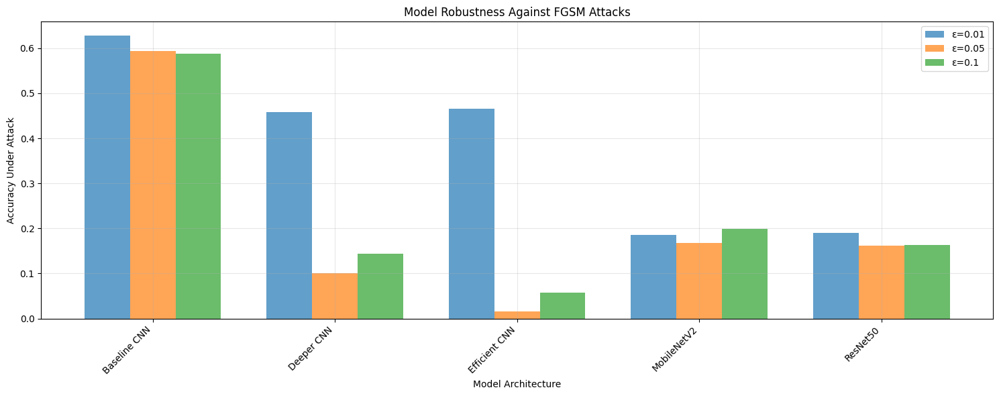

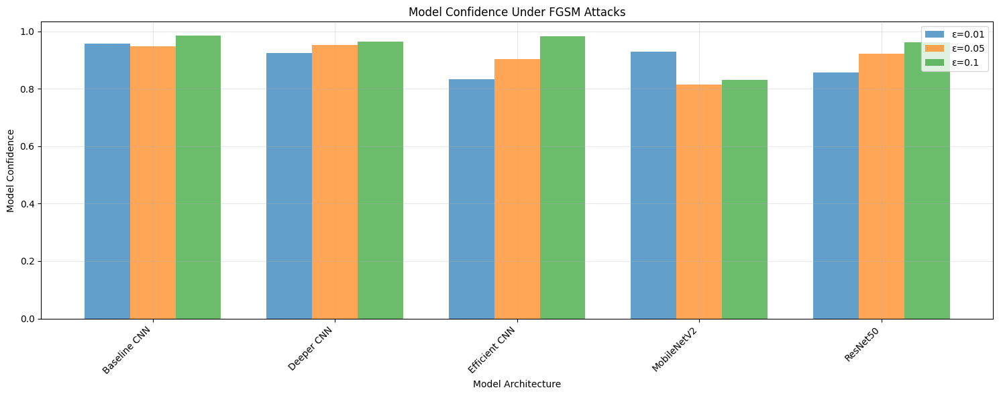

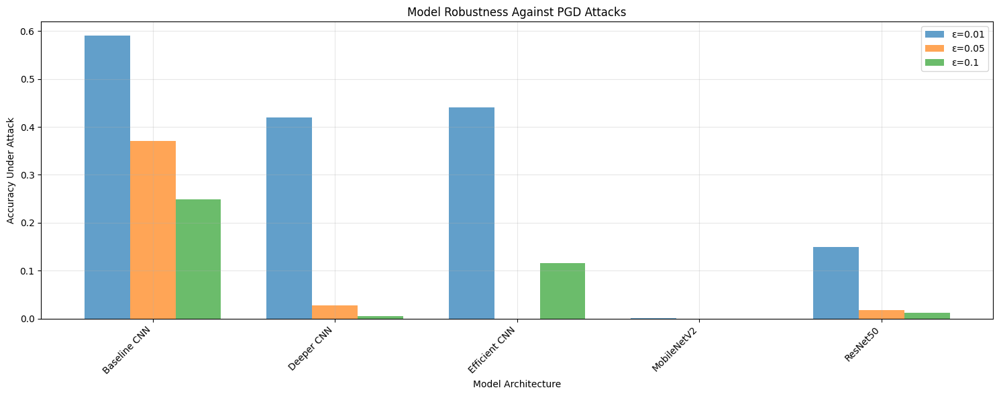

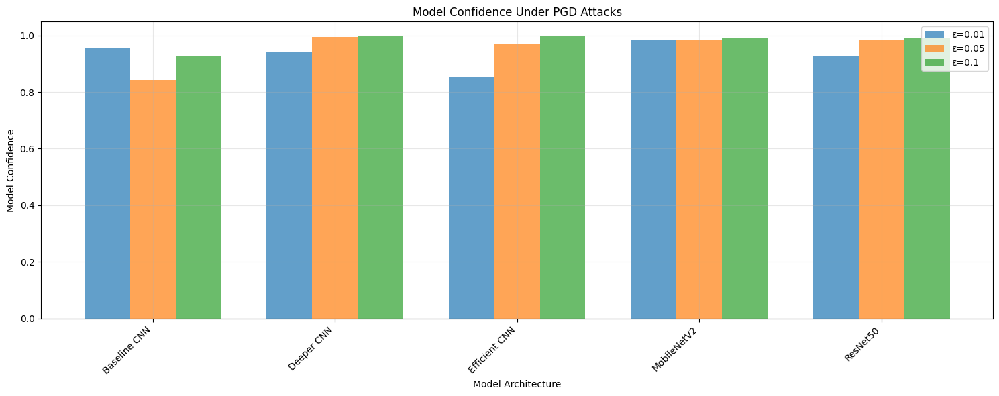


Summary of FGSM Attack Results:
        Model Acc (ε=0.01) Conf (ε=0.01) Acc (ε=0.05) Conf (ε=0.05) Acc (ε=0.1) Conf (ε=0.1)
 Baseline CNN        0.627         0.957        0.593         0.947       0.587        0.984
   Deeper CNN        0.458         0.925        0.101         0.952       0.144        0.963
Efficient CNN        0.465         0.833        0.016         0.903       0.057        0.982
  MobileNetV2        0.186         0.929        0.168         0.815       0.199        0.830
     ResNet50        0.189         0.857        0.161         0.923       0.162        0.963

Summary of PGD Attack Results:
        Model Acc (ε=0.01) Conf (ε=0.01) Acc (ε=0.05) Conf (ε=0.05) Acc (ε=0.1) Conf (ε=0.1)
 Baseline CNN        0.590         0.956        0.370         0.843       0.249        0.926
   Deeper CNN        0.419         0.941        0.027         0.996       0.006        0.998
Efficient CNN        0.441         0.852        0.000         0.969       0.116        0.998
  Mob

In [ ]:
results, summaries = run_visualization(directories)

In [ ]:
@tf.function
def create_fgsm_adversarial(model, images, labels, epsilon):
    """Fast Gradient Sign Method attack"""
    images = tf.cast(images, tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(images)
        predictions = model(images, training=True)
        loss = tf.keras.losses.sparse_categorical_crossentropy(labels, predictions)

    gradients = tape.gradient(loss, images)
    perturbation = epsilon * tf.sign(gradients)
    return tf.clip_by_value(images + perturbation, 0.0, 1.0)

@tf.function
def create_pgd_adversarial(model, images, labels, epsilon, num_steps=10, step_size=0.01):
    """Projected Gradient Descent attack"""
    images = tf.cast(images, tf.float32)
    noise = tf.random.uniform(tf.shape(images), -epsilon, epsilon)
    adversarial = tf.clip_by_value(images + noise, 0.0, 1.0)

    for _ in tf.range(num_steps):
        with tf.GradientTape() as tape:
            tape.watch(adversarial)
            predictions = model(adversarial, training=True)
            loss = tf.keras.losses.sparse_categorical_crossentropy(labels, predictions)

        gradients = tape.gradient(loss, adversarial)
        perturbation = step_size * tf.sign(gradients)
        adversarial = adversarial + perturbation
        adversarial = tf.clip_by_value(adversarial, images - epsilon, images + epsilon)
        adversarial = tf.clip_by_value(adversarial, 0.0, 1.0)

    return adversarial

class TrainingMetrics:
    def __init__(self):
        self.loss = []
        self.clean_acc = []
        self.adv_acc = []
        self.val_clean_acc = []
        self.val_adv_acc = []

def train_step(model, images, labels, attack_type, epsilon, optimizer=None):
    """Single training step"""
    if optimizer is None:
        optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)

    with tf.GradientTape() as tape:

        clean_preds = model(images, training=True)
        clean_loss = tf.keras.losses.sparse_categorical_crossentropy(labels, clean_preds)

        if attack_type == 'fgsm':
            adv_images = create_fgsm_adversarial(model, images, labels, epsilon)
        else:
            adv_images = create_pgd_adversarial(model, images, labels, epsilon)

        adv_preds = model(adv_images, training=True)
        adv_loss = tf.keras.losses.sparse_categorical_crossentropy(labels, adv_preds)

        loss = 0.5 * (clean_loss + adv_loss)

    gradients = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))

    clean_acc = tf.reduce_mean(tf.cast(
        tf.equal(tf.argmax(clean_preds, axis=1), tf.cast(labels, tf.int64)),
        tf.float32))
    adv_acc = tf.reduce_mean(tf.cast(
        tf.equal(tf.argmax(adv_preds, axis=1), tf.cast(labels, tf.int64)),
        tf.float32))

    return tf.reduce_mean(loss), clean_acc, adv_acc

@tf.function
def validate_step(model, images, labels, attack_type, epsilon):
    """Validation step with metrics"""
    clean_preds = model(images, training=False)
    clean_acc = tf.reduce_mean(tf.cast(
        tf.equal(tf.argmax(clean_preds, axis=1), tf.cast(labels, tf.int64)),
        tf.float32))

    if attack_type == 'fgsm':
        adv_images = create_fgsm_adversarial(model, images, labels, epsilon)
    else:
        adv_images = create_pgd_adversarial(model, images, labels, epsilon)

    adv_preds = model(adv_images, training=False)
    adv_acc = tf.reduce_mean(tf.cast(
        tf.equal(tf.argmax(adv_preds, axis=1), tf.cast(labels, tf.int64)),
        tf.float32))

    return clean_acc, adv_acc

def train_single_model_adversarial(model_file, model_name, attempt_num, attack_type, directories):
    """Train a single model with adversarial training"""
    print(f"\n{'='*50}")
    print(f"Training {model_name} - Attempt {attempt_num} - {attack_type.upper()}")
    print(f"{'='*50}")

    base_model_path = os.path.join(directories['models'], model_file)
    tf.keras.backend.clear_session()
    model = tf.keras.models.load_model(base_model_path)
    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)

    if attempt_num == 1:
        epochs = 15
        epsilon = 0.01
    elif attempt_num == 2:
        epochs = 15
        epsilon = 0.02
    else:
        epochs = 20
        epsilon = 0.03

    try:
        metrics = TrainingMetrics()

        for epoch in range(epochs):
            epoch_loss = []
            epoch_clean_acc = []
            epoch_adv_acc = []

            for images, labels in train_ds:
                loss, clean_acc, adv_acc = train_step(
                    model, images, labels, attack_type,
                    epsilon=epsilon,
                    optimizer=optimizer
                )
                epoch_loss.append(float(loss))
                epoch_clean_acc.append(float(clean_acc))
                epoch_adv_acc.append(float(adv_acc))

            val_clean_acc = []
            val_adv_acc = []
            for images, labels in val_ds:
                clean_acc, adv_acc = validate_step(
                    model, images, labels, attack_type,
                    epsilon=epsilon
                )
                val_clean_acc.append(float(clean_acc))
                val_adv_acc.append(float(adv_acc))

            metrics.loss.append(np.mean(epoch_loss))
            metrics.clean_acc.append(np.mean(epoch_clean_acc))
            metrics.adv_acc.append(np.mean(epoch_adv_acc))
            metrics.val_clean_acc.append(np.mean(val_clean_acc))
            metrics.val_adv_acc.append(np.mean(val_adv_acc))

            print(f"\nEpoch {epoch + 1}/{epochs}")
            print(f"Loss: {metrics.loss[-1]:.4f}")
            print(f"Clean Accuracy: {metrics.clean_acc[-1]:.4f}")
            print(f"Adversarial Accuracy: {metrics.adv_acc[-1]:.4f}")
            print(f"Validation Clean Accuracy: {metrics.val_clean_acc[-1]:.4f}")
            print(f"Validation Adversarial Accuracy: {metrics.val_adv_acc[-1]:.4f}")

        save_name = f"{model_name}_attempt{attempt_num}_{attack_type}_adv.keras"
        save_path = os.path.join(directories['drive_models'], save_name)
        model.save(save_path)

        results = {
            'model_path': save_path,
            'metrics': {
                'loss': metrics.loss,
                'clean_acc': metrics.clean_acc,
                'adv_acc': metrics.adv_acc,
                'val_clean_acc': metrics.val_clean_acc,
                'val_adv_acc': metrics.val_adv_acc
            }
        }

        return results

    except Exception as e:
        print(f"Error training {model_name}: {str(e)}")
        return None

    finally:
        del model
        tf.keras.backend.clear_session()

In [ ]:
# Block 1: Attempt 1 Training
def run_attempt_1():
    attempt_results = {}
    models_to_train = [
        ('deeper_cnn.keras', 'Deeper_CNN'),
        ('efficient_cnn.keras', 'Efficient_CNN'),
        ('mobilenetv2.keras', 'MobileNetV2'),
        ('resnet50.keras', 'ResNet50')
    ]

    for model_file, model_name in models_to_train:
        attempt_results[model_name] = {}
        for attack_type in ['fgsm', 'pgd']:
            results = train_single_model_adversarial(
                model_file, model_name, 1, attack_type, directories
            )
            attempt_results[model_name][attack_type] = results

    # Save results
    save_path = os.path.join(directories['results'], 'attempt1_results.pkl')
    with open(save_path, 'wb') as f:
        pickle.dump(attempt_results, f)
    return attempt_results

# # Block 2: Attempt 2 Training
# def run_attempt_2():
#     attempt_results = {}
#     models_to_train = [
#         ('deeper_cnn.keras', 'Deeper_CNN'),
#         ('efficient_cnn.keras', 'Efficient_CNN'),
#         ('mobilenetv2.keras', 'MobileNetV2'),
#         ('resnet50.keras', 'ResNet50')
#     ]

#     for model_file, model_name in models_to_train:
#         attempt_results[model_name] = {}
#         for attack_type in ['fgsm', 'pgd']:
#             results = train_single_model_adversarial(
#                 model_file, model_name, 2, attack_type, directories
#             )
#             attempt_results[model_name][attack_type] = results

#     save_path = os.path.join(directories['results'], 'attempt2_results.pkl')
#     with open(save_path, 'wb') as f:
#         pickle.dump(attempt_results, f)
#     return attempt_results

# # Block 3: Attempt 3 Training
# def run_attempt_3():
#     attempt_results = {}
#     models_to_train = [
#         ('deeper_cnn.keras', 'Deeper_CNN'),
#         ('efficient_cnn.keras', 'Efficient_CNN'),
#         ('mobilenetv2.keras', 'MobileNetV2'),
#         ('resnet50.keras', 'ResNet50')
#     ]

#     for model_file, model_name in models_to_train:
#         attempt_results[model_name] = {}
#         for attack_type in ['fgsm', 'pgd']:
#             results = train_single_model_adversarial(
#                 model_file, model_name, 3, attack_type, directories
#             )
#             attempt_results[model_name][attack_type] = results

#     # Save results
#     save_path = os.path.join(directories['results'], 'attempt3_results.pkl')
#     with open(save_path, 'wb') as f:
#         pickle.dump(attempt_results, f)
#     return attempt_results

In [ ]:
# Skip attempts 2 and 3

In [ ]:
results1 = run_attempt_1()


Training Deeper_CNN - Attempt 1 - FGSM

Epoch 1/15
Loss: 0.8303
Clean Accuracy: 0.9400
Adversarial Accuracy: 0.5849
Validation Clean Accuracy: 0.9141
Validation Adversarial Accuracy: 0.6332

Epoch 2/15
Loss: 0.4811
Clean Accuracy: 0.9304
Adversarial Accuracy: 0.6707
Validation Clean Accuracy: 0.9302
Validation Adversarial Accuracy: 0.6692

Epoch 3/15
Loss: 0.4302
Clean Accuracy: 0.9341
Adversarial Accuracy: 0.7075
Validation Clean Accuracy: 0.9297
Validation Adversarial Accuracy: 0.7067

Epoch 4/15
Loss: 0.4001
Clean Accuracy: 0.9364
Adversarial Accuracy: 0.7260
Validation Clean Accuracy: 0.9219
Validation Adversarial Accuracy: 0.7275

Epoch 5/15
Loss: 0.3697
Clean Accuracy: 0.9422
Adversarial Accuracy: 0.7499
Validation Clean Accuracy: 0.9385
Validation Adversarial Accuracy: 0.7296

Epoch 6/15
Loss: 0.3402
Clean Accuracy: 0.9462
Adversarial Accuracy: 0.7676
Validation Clean Accuracy: 0.9490
Validation Adversarial Accuracy: 0.7541

Epoch 7/15
Loss: 0.3237
Clean Accuracy: 0.9531
Advers

In [ ]:
# results2 = run_attempt_2()
# results3 = run_attempt_3()


Attempt 1 Summary:
           Model Attack  Final Clean Acc  Final Adv Acc  Final Val Clean Acc  \
0     Deeper_CNN   FGSM           0.9782         0.8799               0.9755   
1     Deeper_CNN    PGD           0.9717         0.8383               0.9755   
2  Efficient_CNN   FGSM           0.9718         0.7862               0.9758   
3  Efficient_CNN    PGD           0.9698         0.7351               0.9727   
4    MobileNetV2   FGSM           0.9989         0.9115               0.9552   
5    MobileNetV2    PGD           0.9979         0.4189               0.8571   
6       ResNet50   FGSM           0.9588         0.6861               0.8782   

   Final Val Adv Acc  Best Val Clean Acc  Best Val Adv Acc  Final Loss  
0             0.8786              0.9760            0.8880      0.1904  
1             0.8493              0.9755            0.8493      0.2346  
2             0.7884              0.9758            0.7884      0.2965  
3             0.7301              0.9727       

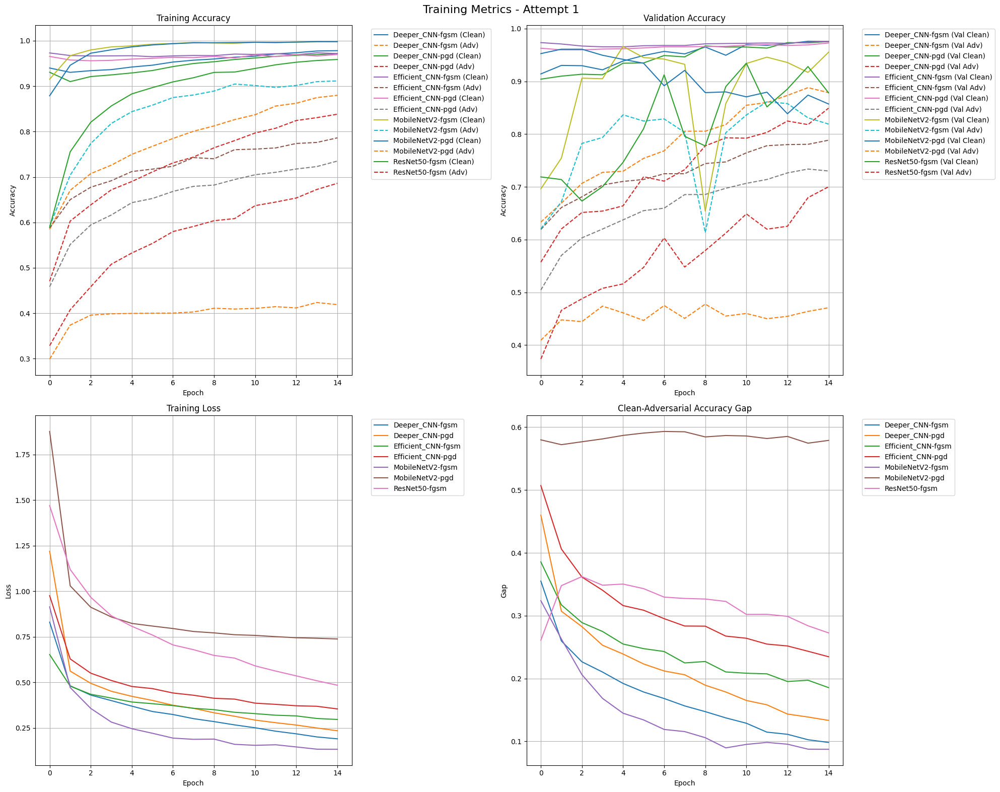

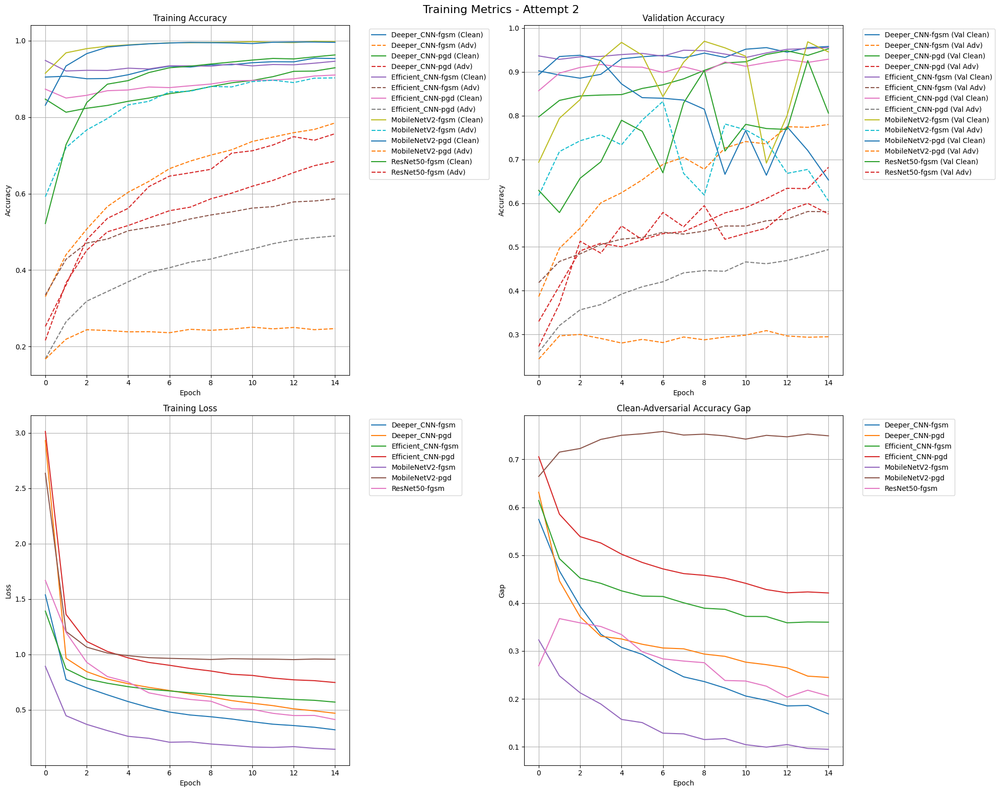

In [ ]:
def plot_training_metrics(results, attempt_num):
    """Plot training metrics for all models in a given attempt"""
    fig, axes = plt.subplots(2, 2, figsize=(20, 16))
    fig.suptitle(f'Training Metrics - Attempt {attempt_num}', fontsize=16)

    for model_name, model_results in results.items():
        for attack_type in ['fgsm', 'pgd']:
            if model_results.get(attack_type) and model_results[attack_type]:
                metrics = model_results[attack_type]['metrics']

                axes[0,0].plot(metrics['clean_acc'], label=f'{model_name}-{attack_type} (Clean)')
                axes[0,0].plot(metrics['adv_acc'], '--', label=f'{model_name}-{attack_type} (Adv)')
                axes[0,1].plot(metrics['val_clean_acc'], label=f'{model_name}-{attack_type} (Val Clean)')
                axes[0,1].plot(metrics['val_adv_acc'], '--', label=f'{model_name}-{attack_type} (Val Adv)')
                axes[1,0].plot(metrics['loss'], label=f'{model_name}-{attack_type}')

                clean_adv_gap = [c - a for c, a in zip(metrics['clean_acc'], metrics['adv_acc'])]
                axes[1,1].plot(clean_adv_gap, label=f'{model_name}-{attack_type}')

    axes[0,0].set_title('Training Accuracy')
    axes[0,0].set_xlabel('Epoch')
    axes[0,0].set_ylabel('Accuracy')
    axes[0,0].grid(True)
    axes[0,0].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    axes[0,1].set_title('Validation Accuracy')
    axes[0,1].set_xlabel('Epoch')
    axes[0,1].set_ylabel('Accuracy')
    axes[0,1].grid(True)
    axes[0,1].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    axes[1,0].set_title('Training Loss')
    axes[1,0].set_xlabel('Epoch')
    axes[1,0].set_ylabel('Loss')
    axes[1,0].grid(True)
    axes[1,0].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    axes[1,1].set_title('Clean-Adversarial Accuracy Gap')
    axes[1,1].set_xlabel('Epoch')
    axes[1,1].set_ylabel('Gap')
    axes[1,1].grid(True)
    axes[1,1].legend(bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    return fig

def create_summary_table(results, attempt_num):
    """Create summary table of final metrics for all models"""
    data = []
    for model_name, model_results in results.items():
        for attack_type in ['fgsm', 'pgd']:
            if model_results.get(attack_type) and model_results[attack_type]:
                metrics = model_results[attack_type]['metrics']
                data.append({
                    'Model': model_name,
                    'Attack': attack_type.upper(),
                    'Final Clean Acc': metrics['clean_acc'][-1],
                    'Final Adv Acc': metrics['adv_acc'][-1],
                    'Final Val Clean Acc': metrics['val_clean_acc'][-1],
                    'Final Val Adv Acc': metrics['val_adv_acc'][-1],
                    'Best Val Clean Acc': max(metrics['val_clean_acc']),
                    'Best Val Adv Acc': max(metrics['val_adv_acc']),
                    'Final Loss': metrics['loss'][-1]
                })

    df = pd.DataFrame(data)
    df = df.round(4)
    df = df.sort_values(['Model', 'Attack'])
    return df

fig1 = plot_training_metrics(results1, 1)
# fig2 = plot_training_metrics(results2, 2)

summary1 = create_summary_table(results1, 1)
# summary2 = create_summary_table(results2, 2)

print("\nAttempt 1 Summary:")
print("=" * 100)
print(summary1)
# print("\nAttempt 2 Summary:")
# print("=" * 100)
# print(summary2)


Detailed Performance Metrics (%):
Model           Clean Accuracy  Worst Adversarial Best Adversarial Best Clean After Training
---------------------------------------------------------------------------
Deeper_CNN      97.7%           0.6%            88.0%           97.8%          
Efficient_CNN   97.4%           0.0%            78.6%           97.2%          
MobileNetV2     96.2%           0.0%            91.1%           99.9%          
ResNet50        93.9%           1.2%            68.6%           95.9%          


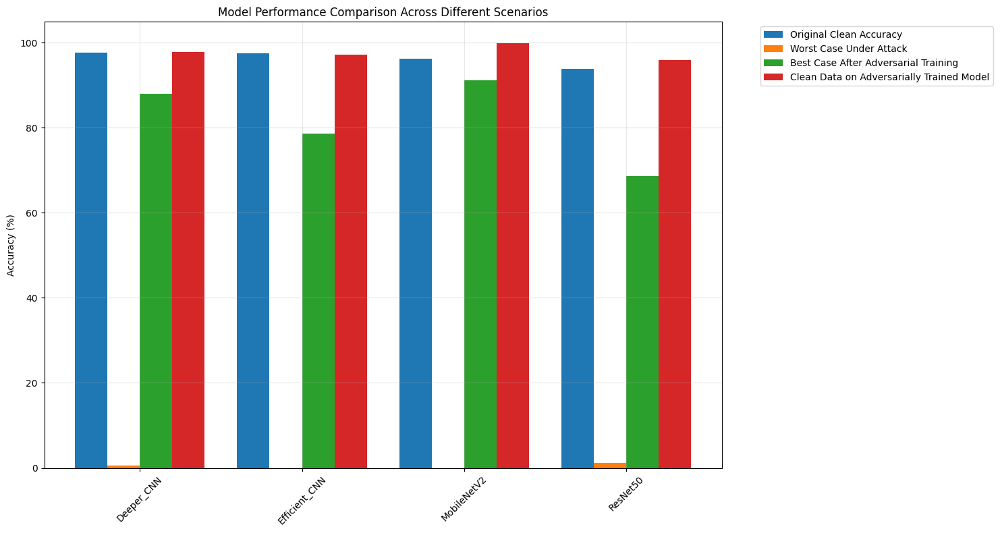

In [ ]:
# Summary metrics
model_metrics = {
    'Deeper_CNN': {
        'clean_baseline': 0.9768,  # Best validation accuracy pre-training (Deeper CNN Best Val Acc)
        'worst_attack': 0.006,    # PGD attack ε=0.1 (Summary of PGD Attack Results)
        'best_adv_trained': 0.8799,  # Best adversarial accuracy after training (Attempt 1, FGSM)
        'adv_trained_clean': 0.9782,  # Clean accuracy post adversarial training (Attempt 1, FGSM)
    },
    'Efficient_CNN': {
        'clean_baseline': 0.9741,  # Best validation accuracy pre-training (Efficient CNN Best Val Acc)
        'worst_attack': 0.000,    # PGD attack ε=0.05 (Summary of PGD Attack Results)
        'best_adv_trained': 0.7862,  # Best adversarial accuracy after training (Attempt 1, FGSM)
        'adv_trained_clean': 0.9718,  # Clean accuracy post adversarial training (Attempt 1, FGSM)
    },
    'MobileNetV2': {
        'clean_baseline': 0.9625,  # Best validation accuracy pre-training (MobileNetV2 Best Val Acc)
        'worst_attack': 0.000,    # PGD attack ε=0.05 (Summary of PGD Attack Results)
        'best_adv_trained': 0.9115,  # Best adversarial accuracy after training (Attempt 1, FGSM)
        'adv_trained_clean': 0.9989,  # Clean accuracy post adversarial training (Attempt 1, FGSM)
    },
    'ResNet50': {
        'clean_baseline': 0.9387,  # Best validation accuracy pre-training (ResNet50 Best Val Acc)
        'worst_attack': 0.012,    # PGD attack ε=0.1 (Summary of PGD Attack Results)
        'best_adv_trained': 0.6861,  # Best adversarial accuracy after training (Attempt 1, FGSM)
        'adv_trained_clean': 0.9588,  # Clean accuracy post adversarial training (Attempt 1, FGSM)
    }
}

# Visualization
plt.figure(figsize=(15, 8))

models = list(model_metrics.keys())
metrics = ['clean_baseline', 'worst_attack', 'best_adv_trained', 'adv_trained_clean']
metric_labels = [
    'Original Clean Accuracy',
    'Worst Case Under Attack',
    'Best Case After Adversarial Training',
    'Clean Data on Adversarially Trained Model'
]

x = np.arange(len(models))
width = 0.2
multiplier = 0

for metric in metrics:
    values = [model_metrics[model][metric] * 100 for model in models]
    offset = width * multiplier
    plt.bar(x + offset, values, width, label=metric_labels[multiplier])
    multiplier += 1

plt.ylabel('Accuracy (%)')
plt.title('Model Performance Comparison Across Different Scenarios')
plt.xticks(x + width * 1.5, models, rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Table
print("\nDetailed Performance Metrics (%):")
print("=" * 100)
headers = ["Model", "Clean Accuracy", "Worst Adversarial", "Best Adversarial", "Best Clean After Training"]
row_format = "{:<15} {:<15} {:<15} {:<15} {:<15}"
print(row_format.format(*headers))
print("-" * 75)
for model in models:
    values = [model] + [f"{model_metrics[model][m]*100:.1f}%" for m in metrics]
    print(row_format.format(*values))


In [ ]:
import pandas as pd

# Data for adversarial training
attempt1_data = [
    {"Model": "Deeper_CNN", "Attack": "FGSM", "Final_Clean_Acc": 0.9782, "Final_Adv_Acc": 0.8799},
    {"Model": "Deeper_CNN", "Attack": "PGD", "Final_Clean_Acc": 0.9717, "Final_Adv_Acc": 0.8383},
    {"Model": "Efficient_CNN", "Attack": "FGSM", "Final_Clean_Acc": 0.9718, "Final_Adv_Acc": 0.7862},
    {"Model": "Efficient_CNN", "Attack": "PGD", "Final_Clean_Acc": 0.9698, "Final_Adv_Acc": 0.7351},
    {"Model": "MobileNetV2", "Attack": "FGSM", "Final_Clean_Acc": 0.9989, "Final_Adv_Acc": 0.9115},
    {"Model": "MobileNetV2", "Attack": "PGD", "Final_Clean_Acc": 0.9979, "Final_Adv_Acc": 0.4189},
    {"Model": "ResNet50", "Attack": "FGSM", "Final_Clean_Acc": 0.9588, "Final_Adv_Acc": 0.6861},
]

# attempt2_data = [
#     {"Model": "Deeper_CNN", "Attack": "FGSM", "Final_Clean_Acc": 0.9536, "Final_Adv_Acc": 0.7849},
#     {"Model": "Deeper_CNN", "Attack": "PGD", "Final_Clean_Acc": 0.9294, "Final_Adv_Acc": 0.6846},
#     {"Model": "Efficient_CNN", "Attack": "FGSM", "Final_Clean_Acc": 0.9465, "Final_Adv_Acc": 0.5863},
#     {"Model": "Efficient_CNN", "Attack": "PGD", "Final_Clean_Acc": 0.9104, "Final_Adv_Acc": 0.4892},
#     {"Model": "MobileNetV2", "Attack": "FGSM", "Final_Clean_Acc": 0.9978, "Final_Adv_Acc": 0.9029},
#     {"Model": "MobileNetV2", "Attack": "PGD", "Final_Clean_Acc": 0.9959, "Final_Adv_Acc": 0.2467},
#     {"Model": "ResNet50", "Attack": "FGSM", "Final_Clean_Acc": 0.9629, "Final_Adv_Acc": 0.7568},
# ]

attempt1_df = pd.DataFrame(attempt1_data)
# attempt2_df = pd.DataFrame(attempt2_data)

# combined_df = attempt1_df.merge(attempt2_df, on=["Model", "Attack"], suffixes=("_Attempt1", "_Attempt2"))

# combined_df.to_csv("adversarial_training_comparison.csv", index=False)
#print(combined_df)
print(attempt1_df)


           Model Attack  Final_Clean_Acc_Attempt1  Final_Adv_Acc_Attempt1  \
0     Deeper_CNN   FGSM                    0.9782                  0.8799   
1     Deeper_CNN    PGD                    0.9717                  0.8383   
2  Efficient_CNN   FGSM                    0.9718                  0.7862   
3  Efficient_CNN    PGD                    0.9698                  0.7351   
4    MobileNetV2   FGSM                    0.9989                  0.9115   
5    MobileNetV2    PGD                    0.9979                  0.4189   
6       ResNet50   FGSM                    0.9588                  0.6861   

   Final_Clean_Acc_Attempt2  Final_Adv_Acc_Attempt2  
0                    0.9536                  0.7849  
1                    0.9294                  0.6846  
2                    0.9465                  0.5863  
3                    0.9104                  0.4892  
4                    0.9978                  0.9029  
5                    0.9959                  0.2467  
6    

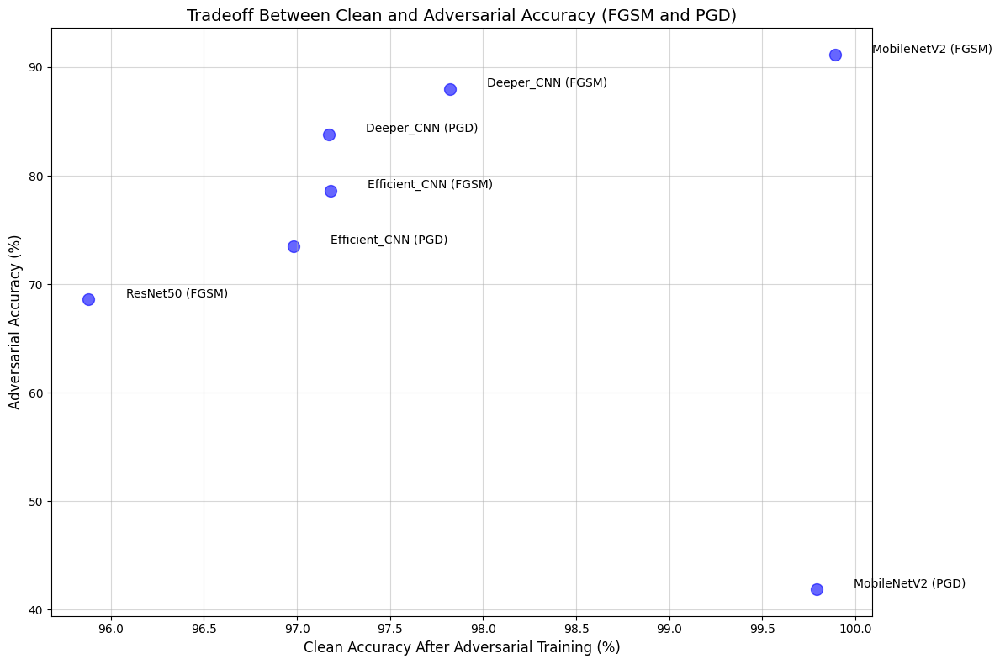

In [ ]:
tradeoff_data = [
    {"Model": "Deeper_CNN", "Attack": "FGSM", "Clean_Acc": 0.9782, "Adv_Acc": 0.8799},
    {"Model": "Deeper_CNN", "Attack": "PGD", "Clean_Acc": 0.9717, "Adv_Acc": 0.8383},
    {"Model": "Efficient_CNN", "Attack": "FGSM", "Clean_Acc": 0.9718, "Adv_Acc": 0.7862},
    {"Model": "Efficient_CNN", "Attack": "PGD", "Clean_Acc": 0.9698, "Adv_Acc": 0.7351},
    {"Model": "MobileNetV2", "Attack": "FGSM", "Clean_Acc": 0.9989, "Adv_Acc": 0.9115},
    {"Model": "MobileNetV2", "Attack": "PGD", "Clean_Acc": 0.9979, "Adv_Acc": 0.4189},
    {"Model": "ResNet50", "Attack": "FGSM", "Clean_Acc": 0.9588, "Adv_Acc": 0.6861},
    # {"Model": "Deeper_CNN", "Attack": "FGSM A2", "Clean_Acc": 0.9536, "Adv_Acc": 0.7849},
    # {"Model": "Deeper_CNN", "Attack": "PGD A2", "Clean_Acc": 0.9294, "Adv_Acc": 0.6846},
    # {"Model": "Efficient_CNN", "Attack": "FGSM A2", "Clean_Acc": 0.9465, "Adv_Acc": 0.5863},
    # {"Model": "Efficient_CNN", "Attack": "PGD A2", "Clean_Acc": 0.9104, "Adv_Acc": 0.4892},
    # {"Model": "MobileNetV2", "Attack": "FGSM A2", "Clean_Acc": 0.9978, "Adv_Acc": 0.9029},
    # {"Model": "MobileNetV2", "Attack": "PGD A2", "Clean_Acc": 0.9959, "Adv_Acc": 0.2467},
    # {"Model": "ResNet50", "Attack": "FGSM A2", "Clean_Acc": 0.9629, "Adv_Acc": 0.7568},
]

clean_acc = [entry["Clean_Acc"] * 100 for entry in tradeoff_data]
adv_acc = [entry["Adv_Acc"] * 100 for entry in tradeoff_data]
annotations = [f"{entry['Model']} ({entry['Attack']})" for entry in tradeoff_data]

plt.figure(figsize=(12, 8))
plt.scatter(clean_acc, adv_acc, color='blue', s=100, alpha=0.6)

for i, annotation in enumerate(annotations):
    plt.text(clean_acc[i] + 0.2, adv_acc[i] + 0.2, annotation, fontsize=10)

plt.xlabel("Clean Accuracy After Adversarial Training (%)", fontsize=12)
plt.ylabel("Adversarial Accuracy (%)", fontsize=12)
plt.title("Tradeoff Between Clean and Adversarial Accuracy (FGSM and PGD)", fontsize=14)
plt.grid(alpha=0.5)
plt.tight_layout()
plt.show()
